# FIFA Score Analysis

This notebook analyzes footballers, changes in their skills (as measured by EA's FIFA), and how those changes affect a player's valuation 

<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#FIFA-Score-Analysis" data-toc-modified-id="FIFA-Score-Analysis-1">FIFA Score Analysis</a></span></li><li><span><a href="#Introduction" data-toc-modified-id="Introduction-2">Introduction</a></span></li><li><span><a href="#Loading-the-Data" data-toc-modified-id="Loading-the-Data-3">Loading the Data</a></span></li><li><span><a href="#Merging-the-Data" data-toc-modified-id="Merging-the-Data-4">Merging the Data</a></span></li><li><span><a href="#Cleaning-the-Data" data-toc-modified-id="Cleaning-the-Data-5">Cleaning the Data</a></span></li><li><span><a href="#Analyzing-the-Data" data-toc-modified-id="Analyzing-the-Data-6">Analyzing the Data</a></span><ul class="toc-item"><li><span><a href="#Non-Performance-Attributes" data-toc-modified-id="Non-Performance-Attributes-6.1">Non-Performance Attributes</a></span></li><li><span><a href="#Performance-Attributes" data-toc-modified-id="Performance-Attributes-6.2">Performance Attributes</a></span></li></ul></li><li><span><a href="#Mixed-Effects-Modeling" data-toc-modified-id="Mixed-Effects-Modeling-7">Mixed-Effects Modeling</a></span></li><li><span><a href="#Testing-the-Model" data-toc-modified-id="Testing-the-Model-8">Testing the Model</a></span></li><li><span><a href="#Conclusion" data-toc-modified-id="Conclusion-9">Conclusion</a></span></li></ul></div>

# Introduction

EA's FIFA data team utilitizes a network of 9,000 football professionals, scouts, and spectators in determining the quality of a player and their overall score for the annual release of the FIFA video game.

Given this rich source of information, we may be able to determine whether changes in certain skills contribute to a high-value player's vaulation and see if those change or patterns can help us predict future high-value players.

The top 500 players in 2019 were selected and their 5-year valuation histories were analyzed to see if there's a statistically significant relationship between changes in skills and player valuation.

In [1]:
# importing revelant libraries
import numpy as np
import pandas as pd
import pandas_profiling
import matplotlib.pyplot as plt
from datetime import datetime
from tabulate import tabulate
import seaborn as sns
import ast, json
import re

from functools import reduce
from collections import Counter
from scipy import stats
import sys

import statsmodels.api as sm
import statsmodels.formula.api as smf

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"
%matplotlib inline

# Loading the Data

* Load in merged data tables of FIFA scores and current valuations
* Note: FIFA data is from Kaggle, valuation data has been webscraped from Transfermarkt; merged with script after data collection

In [2]:
# loading the player and valuation data
df_15 = pd.read_csv('project data/merged_fifa_15.csv')
df_16 = pd.read_csv('project data/merged_fifa_16.csv')
df_17 = pd.read_csv('project data/merged_fifa_17.csv')
df_18 = pd.read_csv('project data/merged_fifa_18.csv')
df_19 = pd.read_csv('project data/merged_fifa_19.csv')
df_20 = pd.read_csv('project data/merged_fifa_20.csv')

In [3]:
# taking look at the output from the loaded tables
df_18

,Unnamed: 0,short_name,name,age,height_cm,weight_kg,nationality,club,overall,potential,...,mentality_composure,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,2017
0,0,Cristiano Ronaldo,Cristiano Ronaldo,32,185,80,Portugal,Real Madrid,94,94,...,95+9,22,31,23,7,11,15,14,11,114.0000
1,1,L. Messi,Lionel Messi,30,170,72,Argentina,FC Barcelona,93,93,...,96+2,13,28,26,6,11,15,14,8,136.8000
2,2,Neymar,Neymar,25,175,68,Brazil,Paris Saint-Germain,92,94,...,92+12,21,24,33,9,9,15,15,11,133.0000
3,3,L. Suárez,Luis Suárez,30,182,86,Uruguay,FC Barcelona,92,92,...,83,30,45,38,27,25,31,33,37,102.6000
4,4,R. Lewandowski,Robert Lewandowski,28,185,79,Poland,FC Bayern München,91,91,...,87,25,42,19,15,6,12,8,10,91.2000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
429,429,A. Haidara,Amadou Haidara,19,174,67,Mali,FC Red Bull Salzburg,61,78,...,53,50,56,54,7,11,8,7,10,1.1987
430,430,G. Mancini,Gianluca Mancini,21,190,77,Italy,Atalanta,60,68,...,52+7,61,65,67,13,12,8,6,8,0.9120
431,431,D. Rice,Declan Rice,18,185,76,Republic of Ireland,West Ham United,59,78,...,60+10,57-1,65+5,61+2,8,11,14,5,9,0.5700
432,432,E. Håland,Erling Haaland,16,190,74,Norway,Molde FK,58,78,...,48,16,11,15,7,14,13,11,7,0.3420


# Merging the Data

* Connect teams to leagues (via table merging)
* Note: Data of teams and associated leagues webscraped from Sofifa
* Join new team/league information to the player/valuation tables

In [4]:
# loading in the team id table in order to merge with corresponding leagues
team_df = pd.read_csv('project data/team_id.csv')

# loading in the league table for merging
league_df = pd.read_csv('project data/teams_and_leagues.csv')

# merging the team table with the league table
team_to_league = team_df.merge(league_df, left_on='team_id', right_on='url')
team_to_league = team_to_league.drop(columns=['url'])
team_to_league.drop_duplicates(subset=['team_id'], keep='first', inplace=True)

# taking look at the team_to_league merged table
team_to_league

,team_id,club,league_name
0,11,Manchester United,English Premier League
2,39,Atalanta,Italian Serie A
4,112172,RB Leipzig,German 1. Bundesliga
6,22,Borussia Dortmund,German 1. Bundesliga
8,9,Liverpool,English Premier League
...,...,...,...
1013,111376,US Boulogne Cote D'Opale,French Ligue 2
1014,111377,Vannes OC,French Ligue 2
1015,110465,Viktoria Žižkov,Czech Republic Gambrinus Liga
1016,110902,Villarreal CF B,Spanish Segunda División


In [5]:
# joining the team_to_league table to the player/valuation tables
fifa_15 = df_15.merge(team_to_league[["club","league_name"]], on="club")
fifa_16 = df_16.merge(team_to_league[["club","league_name"]], on="club")
fifa_17 = df_17.merge(team_to_league[["club","league_name"]], on="club")
fifa_18 = df_18.merge(team_to_league[["club","league_name"]], on="club")
fifa_19 = df_19.merge(team_to_league[["club","league_name"]], on="club")
fifa_20 = df_20.merge(team_to_league[["club","league_name"]], on="club")

# taking look at the newly merged tables
fifa_20

,Unnamed: 0,short_name,name,age,height_cm,weight_kg,nationality,club,overall,potential,...,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,2019,league_name
0,0,L. Messi,Lionel Messi,32,170,72,Argentina,FC Barcelona,94,94,...,33,37,26,6,11,15,14,8,171.0,Spain Primera Division
1,6,M. ter Stegen,Marc-André ter Stegen,27,187,85,Germany,FC Barcelona,90,93,...,25,13,10,88,85,88,88,90,102.6,Spain Primera Division
2,16,L. Suárez,Luis Suárez,32,182,86,Uruguay,FC Barcelona,89,89,...,57,45,38,27,25,31,33,37,57.0,Spain Primera Division
3,19,Sergio Busquets,Sergio Busquets,30,189,76,Spain,FC Barcelona,89,89,...,90,86,80,5,8,13,9,13,57.0,Spain Primera Division
4,20,A. Griezmann,Antoine Griezmann,28,176,73,France,FC Barcelona,89,89,...,59,54,49,14,8,14,13,14,148.2,Spain Primera Division
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
453,444,C. Kouamé,Christian Kouamé,21,185,70,Ivory Coast,Genoa,75,83,...,41,35,32,15,13,6,7,14,21.09,Italian Serie A
454,452,E. Håland,Erling Haaland,18,194,87,Norway,FC Red Bull Salzburg,73,85,...,38,31,15,7,14,13,11,7,17.86,Austrian Football Bundesliga
455,454,W. Saliba,William Saliba,18,192,85,France,AS Saint-Étienne,71,88,...,70,72,69,7,10,6,8,11,21.09,French Ligue 1
456,456,Lucas Rodrigues,Lucas Moura,19,182,74,Brazil,Moreirense FC,63,72,...,22,18,15,11,14,14,9,14,45.6,Portuguese Liga ZON SAGRES


# Cleaning the Data

In [6]:
# taking a look at the -/+ residual data from attribute columns
fifa_15.loc[fifa_15["name"]== "Lionel Messi", ["skill_dribbling"]]

,skill_dribbling
0,96-1


* Note: Attributes data includes residual -/+ signs and values signifying changes from the previous year (as seen on Sofifa, where original data was collected)
* Residual data must be removed to correctly display data for the column year

In [7]:
# listing all columns to find columns affected
fifa_18.columns.tolist()

['Unnamed: 0',
 'short_name',
 'name',
 'age',
 'height_cm',
 'weight_kg',
 'nationality',
 'club',
 'overall',
 'potential',
 'preferred_foot',
 'international_reputation',
 'weak_foot',
 'skill_moves',
 'work_rate',
 'body_type',
 'player_tags',
 'team_position',
 'loaned_from',
 'joined',
 'nation_position',
 'pace',
 'shooting',
 'dribbling',
 'defending',
 'physic',
 'gk_diving',
 'gk_handling',
 'gk_kicking',
 'gk_reflexes',
 'gk_speed',
 'gk_positioning',
 'player_traits',
 'attacking_crossing',
 'attacking_finishing',
 'attacking_heading_accuracy',
 'attacking_short_passing',
 'attacking_volleys',
 'skill_dribbling',
 'skill_curve',
 'skill_fk_accuracy',
 'skill_long_passing',
 'skill_ball_control',
 'movement_acceleration',
 'movement_sprint_speed',
 'movement_agility',
 'movement_reactions',
 'movement_balance',
 'power_shot_power',
 'power_jumping',
 'power_stamina',
 'power_strength',
 'power_long_shots',
 'mentality_aggression',
 'mentality_interceptions',
 'mentality_posi

In [8]:
# selecting the columns affected
extract_columns_list = [
 'attacking_crossing', 
 'attacking_finishing',
 'attacking_heading_accuracy',
 'attacking_short_passing',
 'attacking_volleys',
 'skill_dribbling',
 'skill_curve',
 'skill_fk_accuracy',
 'skill_long_passing',
 'skill_ball_control',
 'movement_acceleration',
 'movement_sprint_speed',
 'movement_agility',
 'movement_reactions',
 'movement_balance',
 'power_shot_power',
 'power_jumping',
 'power_stamina',
 'power_strength',
 'power_long_shots',
 'mentality_aggression',
 'mentality_interceptions',
 'mentality_positioning',
 'mentality_vision',
 'mentality_penalties',
 'mentality_composure',
 'defending_marking',
 'defending_standing_tackle',
 'defending_sliding_tackle',
 'goalkeeping_diving',
 'goalkeeping_handling',
 'goalkeeping_kicking',
 'goalkeeping_positioning',
 'goalkeeping_reflexes']

# creating dataframes list for cleaning the columns using a loop
df_list = [fifa_15, fifa_16, fifa_17, fifa_18, fifa_19, fifa_20]

# cleaning the residual attribute data
for df in df_list:
    for column in extract_columns_list:
        df[column] = df[column].astype(str)
        df[column] = df[column].str.extract('(?<!-|\+)(\d{1,2})', expand=False)
        df[column] = df[column].replace(np.nan, '0')
        df[column] = df[column].astype(np.int64)
        
# taking look at the cleaned attribute data
fifa_15['goalkeeping_positioning']

0      14
1      33
2      15
3       9
4      15
       ..
305    11
306    10
307     6
308    14
309    11
Name: goalkeeping_positioning, Length: 310, dtype: int64

In [9]:
# taking a look at the player traits data
fifa_15['player_traits']

0      Finesse Shot, Speed Dribbler (CPU AI Only), On...
1      Diver, Beat Offside Trap, Selfish, Flair, Tech...
2         Diver, Flair, Technical Dribbler (CPU AI Only)
3                                                  Diver
4                                                    NaN
                             ...                        
305                                                  NaN
306    Flair, Long Shot Taker (CPU AI Only), Technica...
307                                                  NaN
308                                                  NaN
309                                                  NaN
Name: player_traits, Length: 310, dtype: object

In [10]:
# taking a look at the player tags data
fifa_15['player_tags']

0      #Speedster, #Dribbler, #FK Specialist, #Acroba...
1                           #Acrobat, #Clinical Finisher
2                        #Speedster, #Dribbler, #Acrobat
3                                            #Tactician 
4                                                    NaN
                             ...                        
305                                                  NaN
306                                                  NaN
307                                                  NaN
308                                                  NaN
309                                                  NaN
Name: player_tags, Length: 310, dtype: object

* Player traits and player tags data have string artifacts and are not in lists
* String artifacts must be removed and traits/tags re-oganized into lists within the column data

In [11]:
# creating a function to remove string artifacts and convert data for player traits column
def traits_function(lst):
    temp_list = []

    if type(lst) != float:
        lst = lst.replace('(CPU AI Only)',"")
        lst = lst.split(",")
        for x in lst:
            x = x.strip()
            temp_list.append(x)
    return temp_list

# using loop to apply function across player/valuation tables
df_list = [fifa_15, fifa_16, fifa_17, fifa_18, fifa_19, fifa_20]

for df in df_list:
    df['player_traits'] = df['player_traits'].apply(traits_function)
    
# taking look at the cleaned and formatted player traits data
fifa_15['player_traits']

0      [Finesse Shot, Speed Dribbler, One Club Player...
1      [Diver, Beat Offside Trap, Selfish, Flair, Tec...
2                     [Diver, Flair, Technical Dribbler]
3                                                [Diver]
4                                                     []
                             ...                        
305                                                   []
306         [Flair, Long Shot Taker, Technical Dribbler]
307                                                   []
308                                                   []
309                                                   []
Name: player_traits, Length: 310, dtype: object

In [12]:
# creating a function to remove string artifacts and convert data for player tags column
def tags_function(lst):
    temp_list_2 = []

    if type(lst) != float:
        lst = lst.replace('#',"")
        lst = lst.split(",")
        for x in lst:
            x = x.strip()
            x = x.strip('\xa0')
            temp_list_2.append(x)
    return temp_list_2

# using loop to apply function across player/valuation tables
df_list = [fifa_15, fifa_16, fifa_17, fifa_18, fifa_19, fifa_20]

for df in df_list:
    df['player_tags'] = df['player_tags'].apply(tags_function)
    
# taking look at the cleaned and formatted player tags data
fifa_15['player_tags']

0      [Speedster, Dribbler, FK Specialist, Acrobat, ...
1                           [Acrobat, Clinical Finisher]
2                         [Speedster, Dribbler, Acrobat]
3                                            [Tactician]
4                                                     []
                             ...                        
305                                                   []
306                                                   []
307                                                   []
308                                                   []
309                                                   []
Name: player_tags, Length: 310, dtype: object

In [13]:
# renaming the 'Unnamed: 0' column with proper label of 'rank'
df_list = [fifa_15, fifa_16, fifa_17, fifa_18, fifa_19, fifa_20]

for df in df_list:
    df = df.rename(columns={'Unnamed: 0':'rank'}, inplace=True)

In [14]:
# renaming each year's/table's valuation column to 'valuation'
df_list = [fifa_15, fifa_16, fifa_17, fifa_18, fifa_19, fifa_20]
value_dict ={'fifa_15':'2014', 'fifa_16':'2015', 'fifa_17':'2016', 'fifa_18':'2017', 'fifa_19':'2018', 'fifa_20':'2019'}
key_list= ['fifa_15', 'fifa_16', 'fifa_17', 'fifa_18', 'fifa_19', 'fifa_20']

for df,key in zip(df_list,key_list):
    df = df.rename(columns={value_dict[key]:'valuation'}, inplace=True)

In [15]:
# dropping row values with no team position assignment
df_list = [fifa_15, fifa_16, fifa_17, fifa_18, fifa_19, fifa_20]

for df in df_list:
    df = df.dropna(subset=['team_position'], inplace=True)
    
# checking to see if all null team position value rows were dropped
fifa_18['team_position'].isnull().sum()

0

In [16]:
# making sure all columns are the correct dtype
fifa_15.dtypes
fifa_16.dtypes
fifa_17.dtypes
fifa_18.dtypes
fifa_19.dtypes
fifa_19.dtypes

rank                         int64
short_name                  object
name                        object
age                          int64
height_cm                    int64
                            ...   
goalkeeping_kicking          int64
goalkeeping_positioning      int64
goalkeeping_reflexes         int64
valuation                  float64
league_name                 object
Length: 69, dtype: object

rank                         int64
short_name                  object
name                        object
age                          int64
height_cm                    int64
                            ...   
goalkeeping_kicking          int64
goalkeeping_positioning      int64
goalkeeping_reflexes         int64
valuation                  float64
league_name                 object
Length: 69, dtype: object

rank                         int64
short_name                  object
name                        object
age                          int64
height_cm                    int64
                            ...   
goalkeeping_kicking          int64
goalkeeping_positioning      int64
goalkeeping_reflexes         int64
valuation                  float64
league_name                 object
Length: 69, dtype: object

rank                         int64
short_name                  object
name                        object
age                          int64
height_cm                    int64
                            ...   
goalkeeping_kicking          int64
goalkeeping_positioning      int64
goalkeeping_reflexes         int64
valuation                  float64
league_name                 object
Length: 69, dtype: object

rank                         int64
short_name                  object
name                        object
age                          int64
height_cm                    int64
                            ...   
goalkeeping_kicking          int64
goalkeeping_positioning      int64
goalkeeping_reflexes         int64
valuation                  float64
league_name                 object
Length: 69, dtype: object

rank                         int64
short_name                  object
name                        object
age                          int64
height_cm                    int64
                            ...   
goalkeeping_kicking          int64
goalkeeping_positioning      int64
goalkeeping_reflexes         int64
valuation                  float64
league_name                 object
Length: 69, dtype: object

In [17]:
# converting the found non-integer column to int64
fifa_20['valuation'] = fifa_20['valuation'].astype('float64')

In [18]:
# taking a look at what a player/valuation table looks like now
fifa_15

,rank,short_name,name,age,height_cm,weight_kg,nationality,club,overall,potential,...,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,valuation,league_name
0,0,L. Messi,Lionel Messi,27,169,67,Argentina,FC Barcelona,93,95,...,25,21,20,6,11,15,14,8,136.800,Spain Primera Division
1,2,L. Suárez,Luis Suárez,27,181,81,Uruguay,FC Barcelona,89,91,...,30,45,38,27,25,31,33,37,63.840,Spain Primera Division
2,10,Neymar,Neymar,22,175,64,Brazil,FC Barcelona,86,91,...,21,24,33,9,9,15,15,11,74.100,Spain Primera Division
3,19,Sergio Busquets,Sergio Busquets,25,189,73,Spain,FC Barcelona,85,89,...,78,84,79,5,8,13,9,13,48.450,Spain Primera Division
4,37,Pedro,Rui Patrício,26,169,64,Spain,FC Barcelona,83,86,...,30,32,31,5,11,12,15,9,22.800,Spain Primera Division
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
305,301,J. Maddison,James Maddison,17,179,73,England,Coventry City,56,74,...,25,32,29,10,13,13,11,13,0.057,English League One
306,303,D. Alli,Dele Alli,18,187,73,England,Milton Keynes Dons,55,76,...,44,54,48,6,5,8,10,7,1.425,English League One
307,304,J. Gomez,Joe Gomez,17,185,77,England,Charlton Athletic,55,74,...,52,58,55,7,12,13,6,6,0.057,English League Championship
308,307,L. Lima,Lucas Paquetá,19,178,74,Argentina,Unión La Calera,51,55,...,25,25,25,7,13,13,14,8,NaN,Chilian Campeonato Nacional


# Analyzing the Data

* Now the data is cleaned/formatted, we will be analyzing
    1. non-performance attributes like player country, age, height and body type (static attributes)
    2. performance attributes like dribbling, attacking, and agility (changing attributes)
* One makes up a player profile and the other maps changing skillsets

## Non-Performance Attributes

In [19]:
# compiling the non-performance attributes of the top 500 players from 2019
fifa_20_np = fifa_20.loc[:,['rank', 'name', 'age', 'height_cm', 'weight_kg', 'nationality', 'nation_position', 'club', 'preferred_foot', 'weak_foot', 'work_rate',
       'body_type', 'team_position', 'player_traits', 'player_tags', 'potential', 'overall', 'league_name', 'valuation']]
fifa_20_np['nation_position'] = fifa_20['nation_position'].replace({'SUB':np.nan})
fifa_20_np['remaining potential'] = fifa_20['potential'] - fifa_20['overall']

In [20]:
# finding all unique player positions
fifa_20_np['team_position'].unique()

array(['RW', 'GK', 'ST', 'CDM', 'LW', 'LB', 'SUB', 'RCM', 'LCM', 'LCB',
       'RB', 'RCB', 'RES', 'CAM', 'RM', 'LM', 'LS', 'RS', 'CF', 'RDM',
       'LDM', 'CB', 'CM', 'RAM', 'LAM', 'RF', 'LF', 'LWB', 'RWB'],
      dtype=object)

In [21]:
# grouping players by different positions as different positions require different skillsets
fifa_20_attackers_np = fifa_20_np[fifa_20_np['team_position'].isin(['ST', 'LW', 'RW', 'CF', 'LF', 'RF', 'LS', 'RS'])]
fifa_20_midfielders_np = fifa_20_np[fifa_20_np['team_position'].isin(['LCM', 'RCM', 'CAM', 'CDM', 'LDM', 'RDM', 'RM', 'LM', 'LAM', 'RAM', 'CM', 'RWB', 'LWB'])]
fifa_20_defenders_np = fifa_20_np[fifa_20_np['team_position'].isin(['LCB', 'RCB', 'LB', 'RB', 'CB'])]
fifa_20_gks_np = fifa_20_np[fifa_20_np['team_position'].isin(['GK'])]
fifa_20_subs_np = fifa_20_np[fifa_20_np['team_position'].isin(['SUB'])]

Let's use pandas_profiling to get clearer picture of players' non-performance attributes

In [22]:
# for attackers
fifa_20_attackers_np.profile_report()

In [23]:
# for midfielders
fifa_20_midfielders_np.profile_report()

In [24]:
# for defenders
fifa_20_defenders_np.profile_report()

In [25]:
# for goalkeepers
fifa_20_gks_np.profile_report()

In [26]:
# for subs
fifa_20_subs_np.profile_report()

Now we will tabulate player traits and tags, as assigned by FIFA, of the top 500 players:

In [27]:
# counting most common high-value player traits by position
trait_count_20_attackers = []
trait_count_20_midfielders = []
trait_count_20_defenders = []
trait_count_20_gks = []
trait_count_20_subs = []

df_position_list = [fifa_20_attackers_np, fifa_20_midfielders_np, fifa_20_defenders_np, fifa_20_gks_np, fifa_20_subs_np]
traits_count_list = [trait_count_20_attackers, trait_count_20_midfielders, trait_count_20_defenders, trait_count_20_gks, trait_count_20_subs]

for df,result_list in zip(df_position_list,traits_count_list):
    df = df[df['player_traits'].isnull() == False]
    player_traits = np.array([item for lst in df['player_traits'].values for item in lst])
    x = Counter(player_traits).most_common()
    for element in x:
        result_list.append(element)

In [28]:
# most common traits of high-value players by position
trait_count_20_attackers
trait_count_20_midfielders
trait_count_20_defenders
trait_count_20_gks
trait_count_20_subs

[('Selfish', 35),
 ('Early Crosser', 33),
 ('Speed Dribbler', 30),
 ('Crowd Favourite', 30),
 ('Argues with Officials', 29),
 ('Beat Offside Trap', 20),
 ('Finesse Shot', 14),
 ('Outside Foot Shot', 10),
 ('Giant Throw-in', 7),
 ('Power Free-Kick', 7),
 ('Injury Free', 7),
 ('Long Passer', 7),
 ('Diver', 5),
 ('Long Throw-in', 3),
 ('Skilled Dribbling', 3),
 ('Avoids Using Weaker Foot', 3),
 ('Leadership', 2),
 ('Injury Prone', 2),
 ('1-on-1 Rush', 1)]

[('Argues with Officials', 52),
 ('Selfish', 48),
 ('Crowd Favourite', 42),
 ('Finesse Shot', 34),
 ('Early Crosser', 22),
 ('Speed Dribbler', 21),
 ('Diver', 19),
 ('Beat Offside Trap', 19),
 ('Leadership', 18),
 ('Injury Prone', 12),
 ('Power Free-Kick', 10),
 ('Avoids Using Weaker Foot', 7),
 ('Giant Throw-in', 6),
 ('Injury Free', 6),
 ('Long Throw-in', 4),
 ('Dives Into Tackles', 3),
 ('Outside Foot Shot', 2),
 ('Long Passer', 1),
 ('Long Shot Taker', 1)]

[('Long Passer', 20),
 ('Leadership', 17),
 ('Injury Prone', 15),
 ('Early Crosser', 12),
 ('Diver', 12),
 ('Inflexible', 8),
 ('Dives Into Tackles', 7),
 ('Giant Throw-in', 6),
 ('Argues with Officials', 6),
 ('Long Throw-in', 4),
 ('Avoids Using Weaker Foot', 4),
 ('Selfish', 2),
 ('Speed Dribbler', 2),
 ('Power Free-Kick', 2),
 ('Long Shot Taker', 1),
 ('Finesse Shot', 1),
 ('Crowd Favourite', 1)]

[('Swerve Pass', 10),
 ('Acrobatic Clearance', 8),
 ('Flair Passes', 4),
 ('Flair', 4),
 ('Leadership', 2),
 ('Second Wind', 2),
 ('Giant Throw-in', 1),
 ('Diver', 1)]

[('Crowd Favourite', 44),
 ('Selfish', 39),
 ('Argues with Officials', 32),
 ('Early Crosser', 23),
 ('Finesse Shot', 14),
 ('Beat Offside Trap', 14),
 ('Speed Dribbler', 13),
 ('Power Free-Kick', 12),
 ('Injury Prone', 9),
 ('Diver', 8),
 ('Long Passer', 8),
 ('Injury Free', 7),
 ('Skilled Dribbling', 6),
 ('Leadership', 6),
 ('Giant Throw-in', 4),
 ('Long Throw-in', 3),
 ('Outside Foot Shot', 3),
 ('Avoids Using Weaker Foot', 2),
 ('Inflexible', 1),
 ('Dives Into Tackles', 1)]

In [29]:
# counting most common high-value player tags by position
tags_count_20_attackers = []
tags_count_20_midfielders = []
tags_count_20_defenders = []
tags_count_20_gks = []
tags_count_20_subs = []

df_position_list = [fifa_20_attackers_np, fifa_20_midfielders_np, fifa_20_defenders_np, fifa_20_gks_np, fifa_20_subs_np]
tags_count_list = [tags_count_20_attackers, tags_count_20_midfielders, tags_count_20_defenders, tags_count_20_gks, tags_count_20_subs]

for df,result_list in zip(df_position_list,tags_count_list):
    df = df[df['player_traits'].isnull() == False]
    player_traits = np.array([item for lst in df['player_traits'].values for item in lst])
    x = Counter(player_traits).most_common()
    for element in x:
        result_list.append(element)

In [30]:
# most common tags of high-value players by position
tags_count_20_attackers
tags_count_20_midfielders
tags_count_20_defenders
tags_count_20_gks
tags_count_20_subs

[('Selfish', 35),
 ('Early Crosser', 33),
 ('Speed Dribbler', 30),
 ('Crowd Favourite', 30),
 ('Argues with Officials', 29),
 ('Beat Offside Trap', 20),
 ('Finesse Shot', 14),
 ('Outside Foot Shot', 10),
 ('Giant Throw-in', 7),
 ('Power Free-Kick', 7),
 ('Injury Free', 7),
 ('Long Passer', 7),
 ('Diver', 5),
 ('Long Throw-in', 3),
 ('Skilled Dribbling', 3),
 ('Avoids Using Weaker Foot', 3),
 ('Leadership', 2),
 ('Injury Prone', 2),
 ('1-on-1 Rush', 1)]

[('Argues with Officials', 52),
 ('Selfish', 48),
 ('Crowd Favourite', 42),
 ('Finesse Shot', 34),
 ('Early Crosser', 22),
 ('Speed Dribbler', 21),
 ('Diver', 19),
 ('Beat Offside Trap', 19),
 ('Leadership', 18),
 ('Injury Prone', 12),
 ('Power Free-Kick', 10),
 ('Avoids Using Weaker Foot', 7),
 ('Giant Throw-in', 6),
 ('Injury Free', 6),
 ('Long Throw-in', 4),
 ('Dives Into Tackles', 3),
 ('Outside Foot Shot', 2),
 ('Long Passer', 1),
 ('Long Shot Taker', 1)]

[('Long Passer', 20),
 ('Leadership', 17),
 ('Injury Prone', 15),
 ('Early Crosser', 12),
 ('Diver', 12),
 ('Inflexible', 8),
 ('Dives Into Tackles', 7),
 ('Giant Throw-in', 6),
 ('Argues with Officials', 6),
 ('Long Throw-in', 4),
 ('Avoids Using Weaker Foot', 4),
 ('Selfish', 2),
 ('Speed Dribbler', 2),
 ('Power Free-Kick', 2),
 ('Long Shot Taker', 1),
 ('Finesse Shot', 1),
 ('Crowd Favourite', 1)]

[('Swerve Pass', 10),
 ('Acrobatic Clearance', 8),
 ('Flair Passes', 4),
 ('Flair', 4),
 ('Leadership', 2),
 ('Second Wind', 2),
 ('Giant Throw-in', 1),
 ('Diver', 1)]

[('Crowd Favourite', 44),
 ('Selfish', 39),
 ('Argues with Officials', 32),
 ('Early Crosser', 23),
 ('Finesse Shot', 14),
 ('Beat Offside Trap', 14),
 ('Speed Dribbler', 13),
 ('Power Free-Kick', 12),
 ('Injury Prone', 9),
 ('Diver', 8),
 ('Long Passer', 8),
 ('Injury Free', 7),
 ('Skilled Dribbling', 6),
 ('Leadership', 6),
 ('Giant Throw-in', 4),
 ('Long Throw-in', 3),
 ('Outside Foot Shot', 3),
 ('Avoids Using Weaker Foot', 2),
 ('Inflexible', 1),
 ('Dives Into Tackles', 1)]

## Performance Attributes

In [31]:
# selecting the performance attributes of top 500 players from 2019, divided by attackers and defenders
# it should be noted that since SUB positions are subs for all positions, all skill columns apply to them

attackers_columns_list = ['name',
 'attacking_crossing', 
 'attacking_finishing',
 'attacking_heading_accuracy',
 'attacking_short_passing',
 'attacking_volleys',
 'skill_dribbling',
 'skill_curve',
 'skill_fk_accuracy',
 'skill_long_passing',
 'skill_ball_control',
 'movement_acceleration',
 'movement_sprint_speed',
 'movement_agility',
 'movement_reactions',
 'movement_balance',
 'power_shot_power',
 'power_jumping',
 'power_stamina',
 'power_strength',
 'power_long_shots',
 'mentality_aggression',
 'mentality_interceptions',
 'mentality_positioning',
 'mentality_vision',
 'mentality_penalties',
 'mentality_composure',
 'valuation']



defenders_columns_list = ['name',
 'skill_dribbling',
 'skill_curve',
 'skill_fk_accuracy',
 'skill_long_passing',
 'skill_ball_control',
 'movement_acceleration',
 'movement_sprint_speed',
 'movement_agility',
 'movement_reactions',
 'movement_balance',
 'power_shot_power',
 'power_jumping',
 'power_stamina',
 'power_strength',
 'power_long_shots',
 'mentality_aggression',
 'mentality_interceptions',
 'mentality_positioning',
 'mentality_vision',
 'mentality_penalties',
 'mentality_composure',
 'defending_marking',
 'defending_standing_tackle',
 'defending_sliding_tackle',
 'goalkeeping_diving',
 'goalkeeping_handling',
 'goalkeeping_kicking',
 'goalkeeping_positioning',
 'goalkeeping_reflexes',
 'valuation']

sub_columns_list = ['name',
 'attacking_crossing', 
 'attacking_finishing',
 'attacking_heading_accuracy',
 'attacking_short_passing',
 'attacking_volleys',
 'skill_dribbling',
 'skill_curve',
 'skill_fk_accuracy',
 'skill_long_passing',
 'skill_ball_control',
 'movement_acceleration',
 'movement_sprint_speed',
 'movement_agility',
 'movement_reactions',
 'movement_balance',
 'power_shot_power',
 'power_jumping',
 'power_stamina',
 'power_strength',
 'power_long_shots',
 'mentality_aggression',
 'mentality_interceptions',
 'mentality_positioning',
 'mentality_vision',
 'mentality_penalties',
 'mentality_composure',
 'defending_marking',
 'defending_standing_tackle',
 'defending_sliding_tackle',
 'goalkeeping_diving',
 'goalkeeping_handling',
 'goalkeeping_kicking',
 'goalkeeping_positioning',
 'goalkeeping_reflexes',
 'valuation']


# dividing the player/valuation tables by position
fifa_15_attackers = fifa_15[fifa_15['team_position'].isin(['ST', 'LS' 'RS', 'CF', 'LF', 'RF', 'LW', 'RW'])]
fifa_15_midfielders = fifa_15[fifa_15['team_position'].isin(['RM', 'LM', 'CAM','LAM', 'RAM', 'LCM', 'RCM','CM','CDM','LDM', 'RDM'])]
fifa_15_defenders = fifa_15[fifa_15['team_position'].isin(['RWB', 'LWB', 'LB', 'RB', 'LCB', 'RCB','CB'])]
fifa_15_gks = fifa_15[fifa_15['team_position'].isin(['GK'])]
fifa_15_subs = fifa_15[fifa_15['team_position'].isin(['SUB'])]

fifa_16_attackers = fifa_16[fifa_16['team_position'].isin(['ST', 'LS' 'RS', 'CF', 'LF', 'RF', 'LW', 'RW'])]
fifa_16_midfielders = fifa_16[fifa_16['team_position'].isin(['RM', 'LM', 'CAM','LAM', 'RAM', 'LCM', 'RCM','CM','CDM','LDM', 'RDM'])]
fifa_16_defenders = fifa_16[fifa_16['team_position'].isin(['RWB', 'LWB', 'LB', 'RB', 'LCB', 'RCB','CB'])]
fifa_16_gks = fifa_16[fifa_16['team_position'].isin(['GK'])]
fifa_16_subs = fifa_16[fifa_16['team_position'].isin(['SUB'])]

fifa_17_attackers = fifa_17[fifa_17['team_position'].isin(['ST', 'LS' 'RS', 'CF', 'LF', 'RF', 'LW', 'RW'])]
fifa_17_midfielders = fifa_17[fifa_17['team_position'].isin(['RM', 'LM', 'CAM','LAM', 'RAM', 'LCM', 'RCM','CM','CDM','LDM', 'RDM'])]
fifa_17_defenders = fifa_17[fifa_17['team_position'].isin(['RWB', 'LWB', 'LB', 'RB', 'LCB', 'RCB','CB'])]
fifa_17_gks = fifa_17[fifa_17['team_position'].isin(['GK'])]
fifa_17_subs = fifa_17[fifa_17['team_position'].isin(['SUB'])]

fifa_18_attackers = fifa_18[fifa_18['team_position'].isin(['ST', 'LS' 'RS', 'CF', 'LF', 'RF', 'LW', 'RW'])]
fifa_18_midfielders = fifa_18[fifa_18['team_position'].isin(['RM', 'LM', 'CAM','LAM', 'RAM', 'LCM', 'RCM','CM','CDM','LDM', 'RDM'])]
fifa_18_defenders = fifa_18[fifa_18['team_position'].isin(['RWB', 'LWB', 'LB', 'RB', 'LCB', 'RCB','CB'])]
fifa_18_gks = fifa_18[fifa_18['team_position'].isin(['GK'])]
fifa_18_subs = fifa_18[fifa_18['team_position'].isin(['SUB'])]

fifa_19_attackers = fifa_19[fifa_19['team_position'].isin(['ST', 'LS' 'RS', 'CF', 'LF', 'RF', 'LW', 'RW'])]
fifa_19_midfielders = fifa_19[fifa_19['team_position'].isin(['RM', 'LM', 'CAM','LAM', 'RAM', 'LCM', 'RCM','CM','CDM','LDM', 'RDM'])]
fifa_19_defenders = fifa_19[fifa_19['team_position'].isin(['RWB', 'LWB', 'LB', 'RB', 'LCB', 'RCB','CB'])]
fifa_19_gks = fifa_19[fifa_19['team_position'].isin(['GK'])]
fifa_19_subs = fifa_19[fifa_19['team_position'].isin(['SUB'])]

fifa_20_attackers = fifa_20[fifa_20['team_position'].isin(['ST', 'LS' 'RS', 'CF', 'LF', 'RF', 'LW', 'RW'])]
fifa_20_midfielders = fifa_20[fifa_20['team_position'].isin(['RM', 'LM', 'CAM','LAM', 'RAM', 'LCM', 'RCM','CM','CDM','LDM', 'RDM'])]
fifa_20_defenders = fifa_20[fifa_20['team_position'].isin(['RWB', 'LWB', 'LB', 'RB', 'LCB', 'RCB','CB'])]
fifa_20_gks = fifa_20[fifa_20['team_position'].isin(['GK'])]
fifa_20_subs = fifa_20[fifa_20['team_position'].isin(['SUB'])]


# narrowing the new position-specific tables to the appropropriate performance attributes
fifa_15_attackers = fifa_15_attackers[attackers_columns_list]
fifa_15_midfielders = fifa_15_midfielders[attackers_columns_list]
fifa_15_defenders = fifa_15_defenders[defenders_columns_list]
fifa_15_gks = fifa_15_gks[defenders_columns_list]
fifa_15_subs = fifa_15_subs[sub_columns_list]

fifa_16_attackers = fifa_16_attackers[attackers_columns_list]
fifa_16_midfielders = fifa_16_midfielders[attackers_columns_list]
fifa_16_defenders = fifa_16_defenders[defenders_columns_list]
fifa_16_gks = fifa_16_gks[defenders_columns_list]
fifa_16_subs = fifa_16_subs[sub_columns_list]

fifa_17_attackers = fifa_17_attackers[attackers_columns_list]
fifa_17_midfielders = fifa_17_midfielders[attackers_columns_list]
fifa_17_defenders = fifa_17_defenders[defenders_columns_list]
fifa_17_gks = fifa_17_gks[defenders_columns_list]
fifa_17_subs = fifa_17_subs[sub_columns_list]

fifa_18_attackers = fifa_18_attackers[attackers_columns_list]
fifa_18_midfielders = fifa_18_midfielders[attackers_columns_list]
fifa_18_defenders = fifa_18_defenders[defenders_columns_list]
fifa_18_gks = fifa_18_gks[defenders_columns_list]
fifa_18_subs = fifa_18_subs[sub_columns_list]

fifa_19_attackers = fifa_19_attackers[attackers_columns_list]
fifa_19_midfielders = fifa_19_midfielders[attackers_columns_list]
fifa_19_defenders = fifa_19_defenders[defenders_columns_list]
fifa_19_gks = fifa_19_gks[defenders_columns_list]
fifa_19_subs = fifa_19_subs[sub_columns_list]

fifa_20_attackers = fifa_20_attackers[attackers_columns_list]
fifa_20_midfielders = fifa_20_midfielders[attackers_columns_list]
fifa_20_defenders = fifa_20_defenders[defenders_columns_list]
fifa_20_gks = fifa_20_gks[defenders_columns_list]
fifa_20_subs = fifa_20_subs[sub_columns_list]


# let's a take a look at one of the tables
fifa_15_attackers

# then at the sample size for the largest set of data, FIFA 20
len(fifa_20_attackers)
len(fifa_20_midfielders)
len(fifa_20_defenders)
len(fifa_20_gks)
len(fifa_20_subs)

,name,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,...,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,valuation
0,Lionel Messi,84,94,71,89,85,96,89,90,76,...,77,60,88,48,22,92,90,76,0,136.800
2,Neymar,71,85,62,72,83,94,78,78,72,...,86,45,70,56,36,87,72,81,0,74.100
4,Rui Patrício,78,80,55,83,70,84,81,57,74,...,78,52,73,56,49,85,75,66,0,22.800
10,Cristiano Ronaldo,83,95,86,82,87,93,88,79,72,...,89,79,93,63,24,91,81,85,0,121.600
11,Gareth Bale,84,81,74,84,76,87,87,85,80,...,90,79,88,77,59,83,79,76,0,91.200
16,Karim Benzema,75,88,78,84,77,82,80,73,47,...,74,78,78,65,22,87,81,82,0,45.030
25,Diego Costa,63,90,82,65,81,82,58,59,48,...,85,91,69,89,40,87,74,76,0,38.760
39,Sergio Agüero,70,89,68,84,85,89,82,72,63,...,66,68,78,57,24,87,83,86,0,51.300
44,Ciro Immobile,54,85,79,70,80,74,69,50,48,...,77,77,70,81,28,86,60,74,0,14.630
54,Mesut Özil,83,74,54,88,77,87,84,79,80,...,64,57,75,56,24,83,92,76,0,54.150


57

127

89

19

125

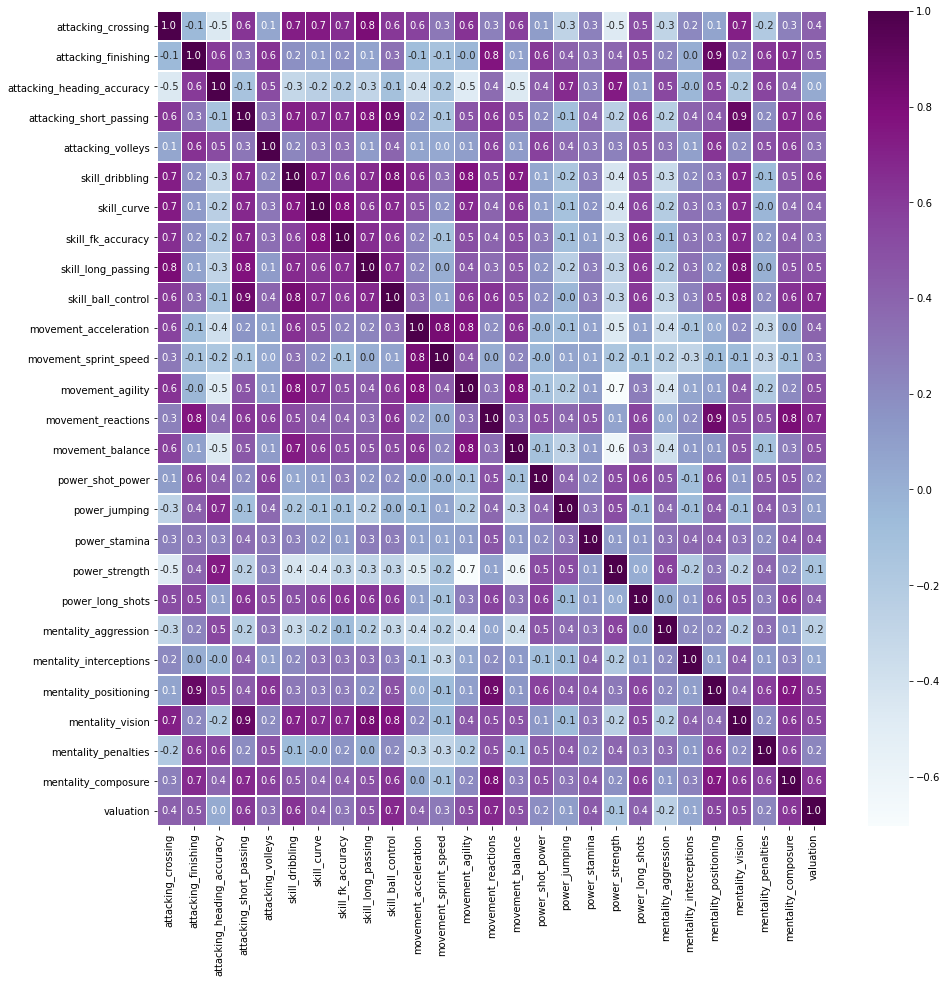

In [32]:
# taking a look at the correlation between attribute scores and a player's valuation: attackers
f,ax = plt.subplots(figsize = (15,15))
sns.heatmap(fifa_20_attackers.corr(),annot = True,linewidths=.5,fmt = '.1f',ax=ax, cmap="BuPu")
plt.show()

In [33]:
# looking at the moderate to high correlations with p-values < 0.05: attackers 
corr_df = fifa_20_attackers.corr()

def calculate_pvalues(df):
    df = df.dropna()._get_numeric_data()
    dfcols = pd.DataFrame(columns=df.columns)
    pvalues = dfcols.transpose().join(dfcols, how='outer')
    for r in df.columns:
        for c in df.columns:
            pvalues[r][c] = round(stats.pearsonr(df[r], df[c])[1], 4)
    return pvalues

p_value_attackers = calculate_pvalues(fifa_20_attackers)

sig_df = p_value_attackers.loc[p_value_attackers['valuation']<.05, ['valuation']]
corr_sig_df = sig_df.merge(corr_df, left_index=True, right_index=True)
corr_sig_df.loc[corr_sig_df["valuation_y"] >= 0.50, ['valuation_y']]

,valuation_y
attacking_short_passing,0.610885
skill_dribbling,0.627765
skill_ball_control,0.679814
movement_agility,0.501230
movement_reactions,0.679908
mentality_positioning,0.549398
mentality_vision,0.542405
mentality_composure,0.619534
valuation,1.000000


Text(0.5, 1.1, 'Attackers')

Text(19.074999999999996, 0.5, 'valuation (mn)')

Text(19.074999999999996, 0.5, 'valuation (mn)')

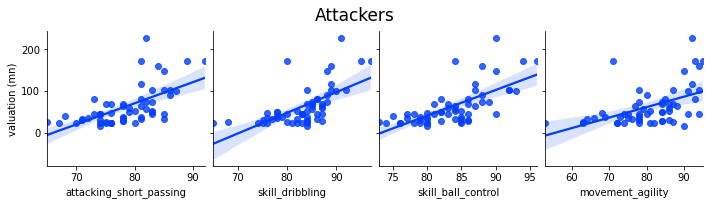

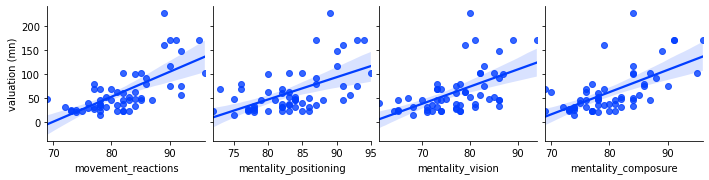

In [34]:
# looking at the graphs for the moderate to high correlated attributes for attackers
sns.set_palette('bright')
x = sns.pairplot(fifa_20_attackers, x_vars=['attacking_short_passing','skill_dribbling', 'skill_ball_control', 'movement_agility'], y_vars = 'valuation', kind='reg', diag_kind = None)
x.fig.suptitle("Attackers", y= 1.1, fontsize=17, fontweight = 500)
y = sns.pairplot(fifa_20_attackers, x_vars=['movement_reactions','mentality_positioning', 'mentality_vision', 'mentality_composure'], y_vars = 'valuation', kind='reg', diag_kind = None)
x.axes[0,0].set_ylabel('valuation (mn)')
y.axes[0,0].set_ylabel('valuation (mn)')

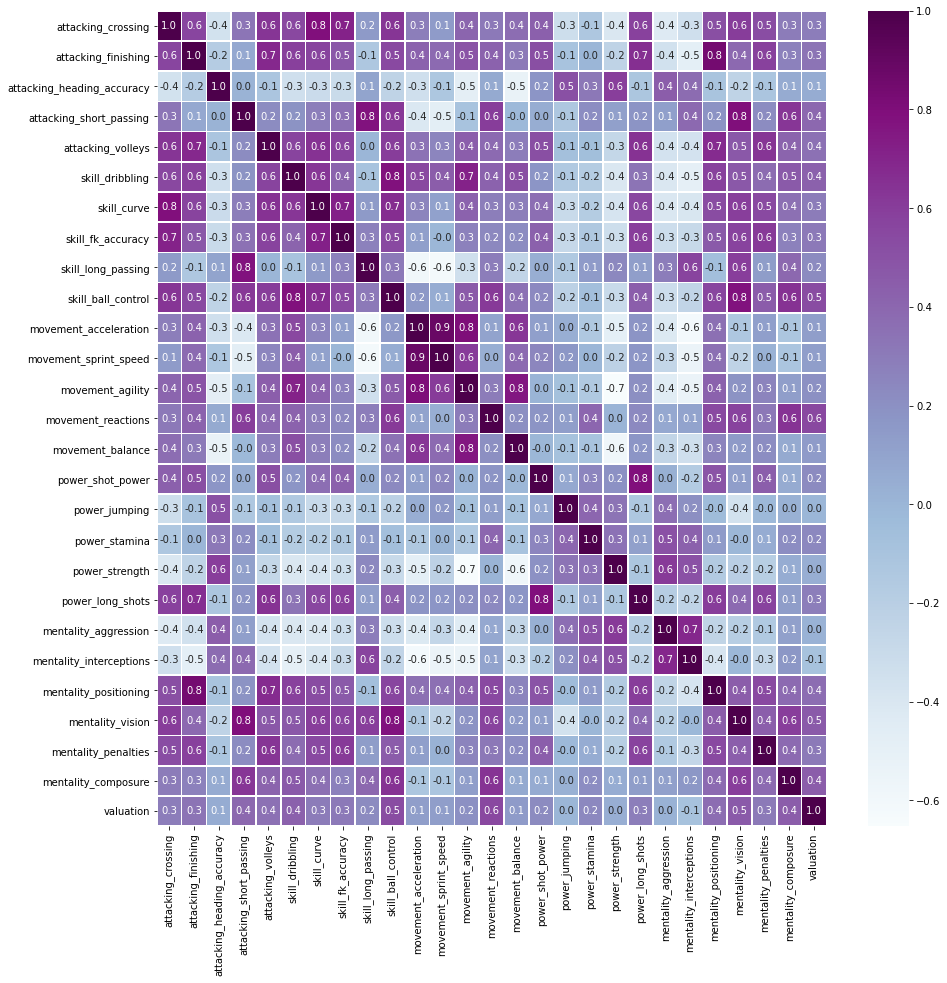

In [35]:
# taking a look at the correlation between attribute scores and a player's valuation: midfielders
f,ax = plt.subplots(figsize = (15,15))
sns.heatmap(fifa_20_midfielders.corr(),annot = True,linewidths=.5,fmt = '.1f',ax=ax, cmap="BuPu")
plt.show()

In [36]:
# looking at the moderate to high correlations with p-values < 0.05: midfielders
corr_df = fifa_20_midfielders.corr()

def calculate_pvalues(df):
    df = df.dropna()._get_numeric_data()
    dfcols = pd.DataFrame(columns=df.columns)
    pvalues = dfcols.transpose().join(dfcols, how='outer')
    for r in df.columns:
        for c in df.columns:
            pvalues[r][c] = round(stats.pearsonr(df[r], df[c])[1], 4)
    return pvalues

p_value_midfielders = calculate_pvalues(fifa_20_midfielders)

sig_df = p_value_midfielders.loc[p_value_midfielders['valuation']<.05, ['valuation']]
corr_sig_df = sig_df.merge(corr_df, left_index=True, right_index=True)
corr_sig_df.loc[corr_sig_df["valuation_y"] >= 0.50, ['valuation_y']]

,valuation_y
skill_ball_control,0.535038
movement_reactions,0.553135
valuation,1.000000


Text(0.5, 1.1, 'Midfielders')

Text(15.475000000000001, 0.5, 'valuation (mn)')

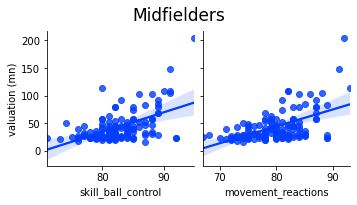

In [37]:
# looking at the graphs for the moderate to high correlated attributes for midfielders
x = sns.pairplot(fifa_20_midfielders, x_vars=['skill_ball_control', 'movement_reactions'], y_vars = 'valuation', kind='reg', diag_kind = None)
x.fig.suptitle("Midfielders", y= 1.1, fontsize=17, fontweight = 500)
x.axes[0,0].set_ylabel('valuation (mn)')

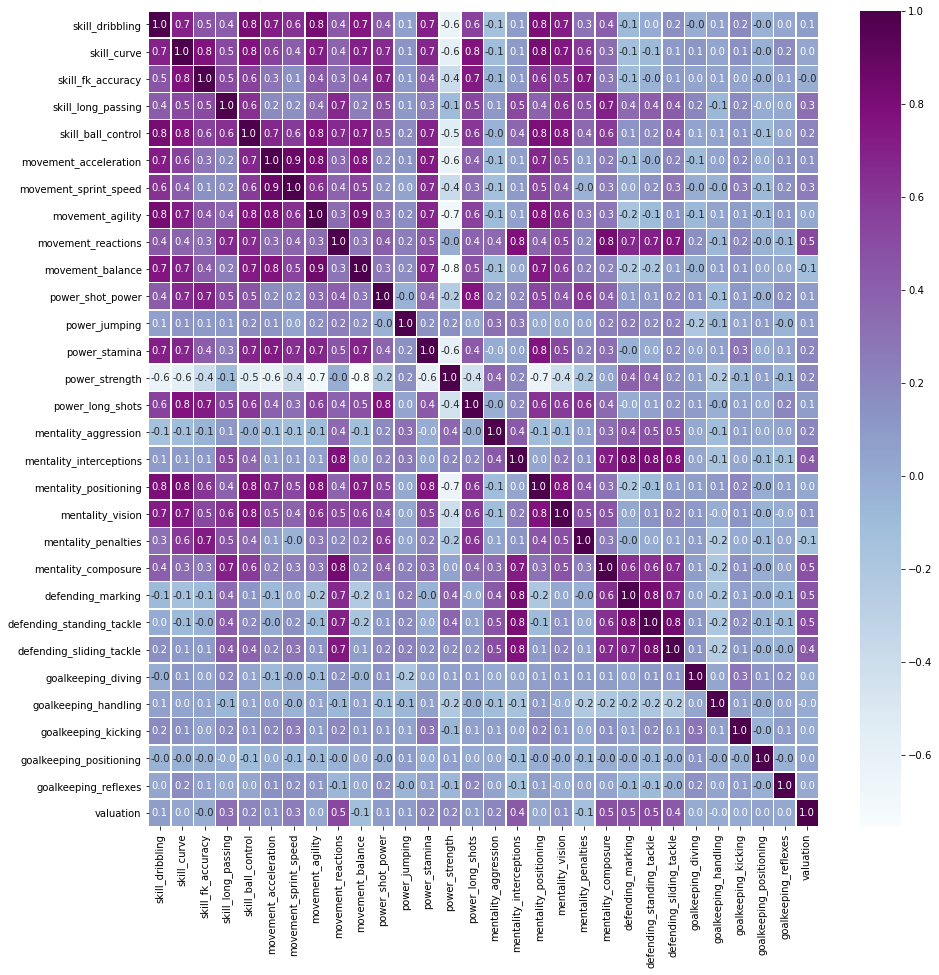

In [38]:
# taking a look at the correlation between attribute scores and a player's valuation: defenders
f,ax = plt.subplots(figsize = (15,15))
sns.heatmap(fifa_20_defenders.corr(),annot = True,linewidths=.5,fmt = '.1f',ax=ax, cmap="BuPu")
plt.show()

In [39]:
# looking at the moderate to high correlations with p-values < 0.05: defenders
corr_df = fifa_20_defenders.corr()

def calculate_pvalues(df):
    df = df.dropna()._get_numeric_data()
    dfcols = pd.DataFrame(columns=df.columns)
    pvalues = dfcols.transpose().join(dfcols, how='outer')
    for r in df.columns:
        for c in df.columns:
            pvalues[r][c] = round(stats.pearsonr(df[r], df[c])[1], 4)
    return pvalues

p_value_defenders = calculate_pvalues(fifa_20_defenders)

sig_df = p_value_defenders.loc[p_value_defenders['valuation']<.05, ['valuation']]
corr_sig_df = sig_df.merge(corr_df, left_index=True, right_index=True)
corr_sig_df.loc[corr_sig_df["valuation_y"] >= 0.50, ['valuation_y']]

,valuation_y
movement_reactions,0.520830
defending_standing_tackle,0.507729
valuation,1.000000


Text(0.5, 1.1, 'Defenders')

Text(15.475000000000001, 0.5, 'valuation (mn)')

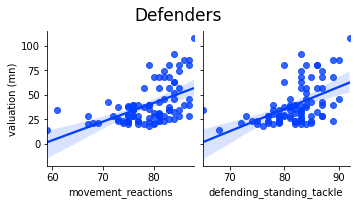

In [40]:
# looking at the graphs for the moderate to high correlated attributes for defenders
x = sns.pairplot(fifa_20_defenders, x_vars=['movement_reactions', 'defending_standing_tackle'], y_vars = 'valuation', kind='reg', diag_kind = None)
x.fig.suptitle("Defenders", y= 1.1, fontsize=17, fontweight = 500)
x.axes[0,0].set_ylabel('valuation (mn)')

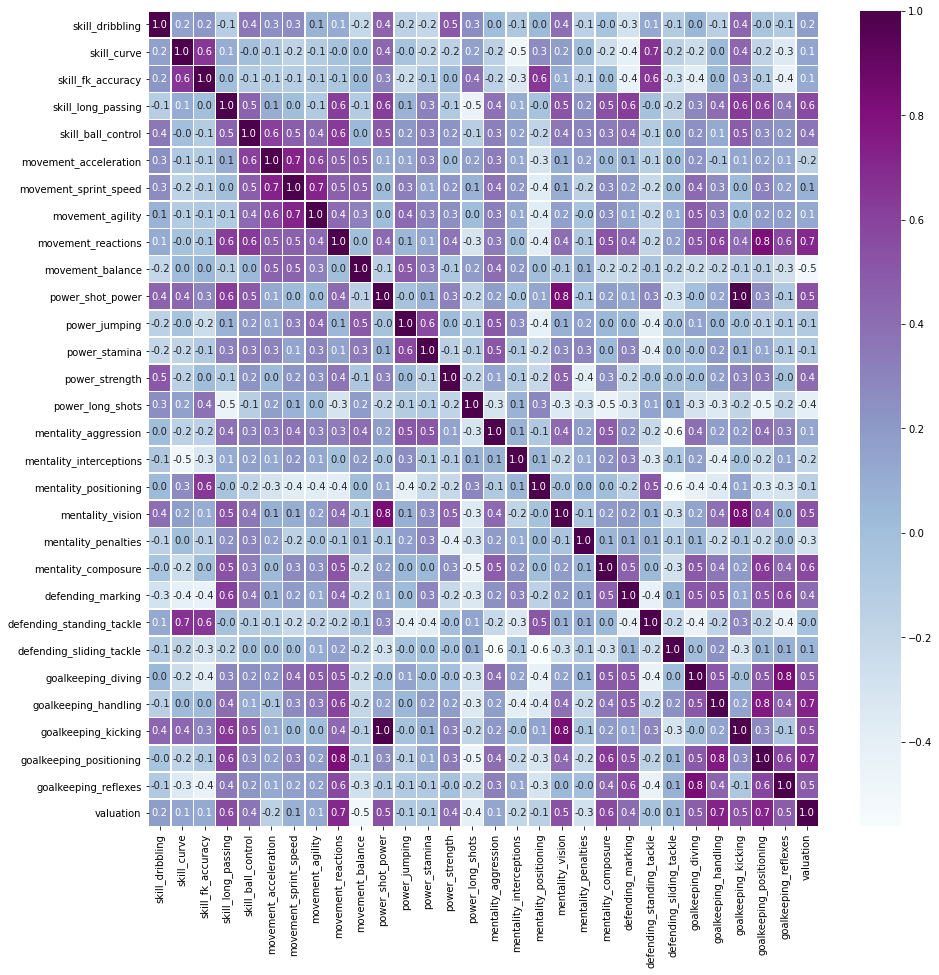

In [41]:
# taking a look at the correlation between attribute scores and a player's valuation: gks
f,ax = plt.subplots(figsize = (15,15))
sns.heatmap(fifa_20_gks.corr(),annot = True,linewidths=.5,fmt = '.1f',ax=ax, cmap="BuPu")
plt.show()

In [42]:
# looking at the moderate to high correlations with p-values < 0.05: gks
corr_df = fifa_20_gks.corr()

def calculate_pvalues(df):
    df = df.dropna()._get_numeric_data()
    dfcols = pd.DataFrame(columns=df.columns)
    pvalues = dfcols.transpose().join(dfcols, how='outer')
    for r in df.columns:
        for c in df.columns:
            pvalues[r][c] = round(stats.pearsonr(df[r], df[c])[1], 4)
    return pvalues

p_value_gks = calculate_pvalues(fifa_20_gks)

sig_df = p_value_gks.loc[p_value_gks['valuation']<.05, ['valuation']]
corr_sig_df = sig_df.merge(corr_df, left_index=True, right_index=True)
corr_sig_df.loc[corr_sig_df["valuation_y"] >= 0.50, ['valuation_y']]

,valuation_y
skill_long_passing,0.562403
movement_reactions,0.705183
power_shot_power,0.540867
mentality_vision,0.528514
mentality_composure,0.566851
goalkeeping_handling,0.726189
goalkeeping_kicking,0.531367
goalkeeping_positioning,0.722551
valuation,1.000000


<Figure size 1440x1224 with 0 Axes>

Text(0.5, 1.1, 'Goalkeepers')

Text(19.074999999999996, 0.5, 'valuation (mn)')

Text(19.074999999999996, 0.5, 'valuation (mn)')

<Figure size 1440x1224 with 0 Axes>

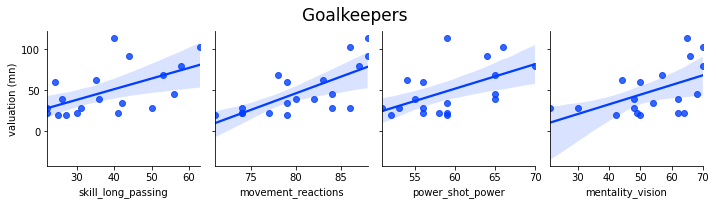

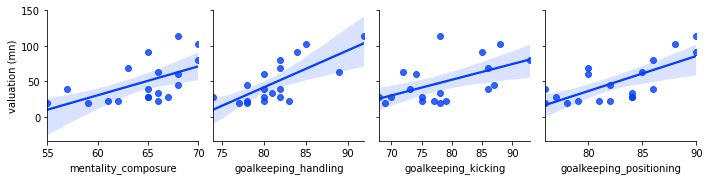

In [43]:
# looking at the graphs for the moderate to high correlated attributes for gks
plt.figure(figsize=(20,17))
x = sns.pairplot(fifa_20_gks, x_vars=['skill_long_passing', 'movement_reactions', 'power_shot_power', 'mentality_vision'], y_vars = 'valuation', kind='reg', diag_kind = None)
x.fig.suptitle("Goalkeepers", y= 1.1, fontsize=17, fontweight = 500)
y = sns.pairplot(fifa_20_gks, x_vars=['mentality_composure', 'goalkeeping_handling', 'goalkeeping_kicking', 'goalkeeping_positioning'], y_vars = 'valuation', kind='reg', diag_kind = None)
x.axes[0,0].set_ylabel('valuation (mn)')
y.axes[0,0].set_ylabel('valuation (mn)')

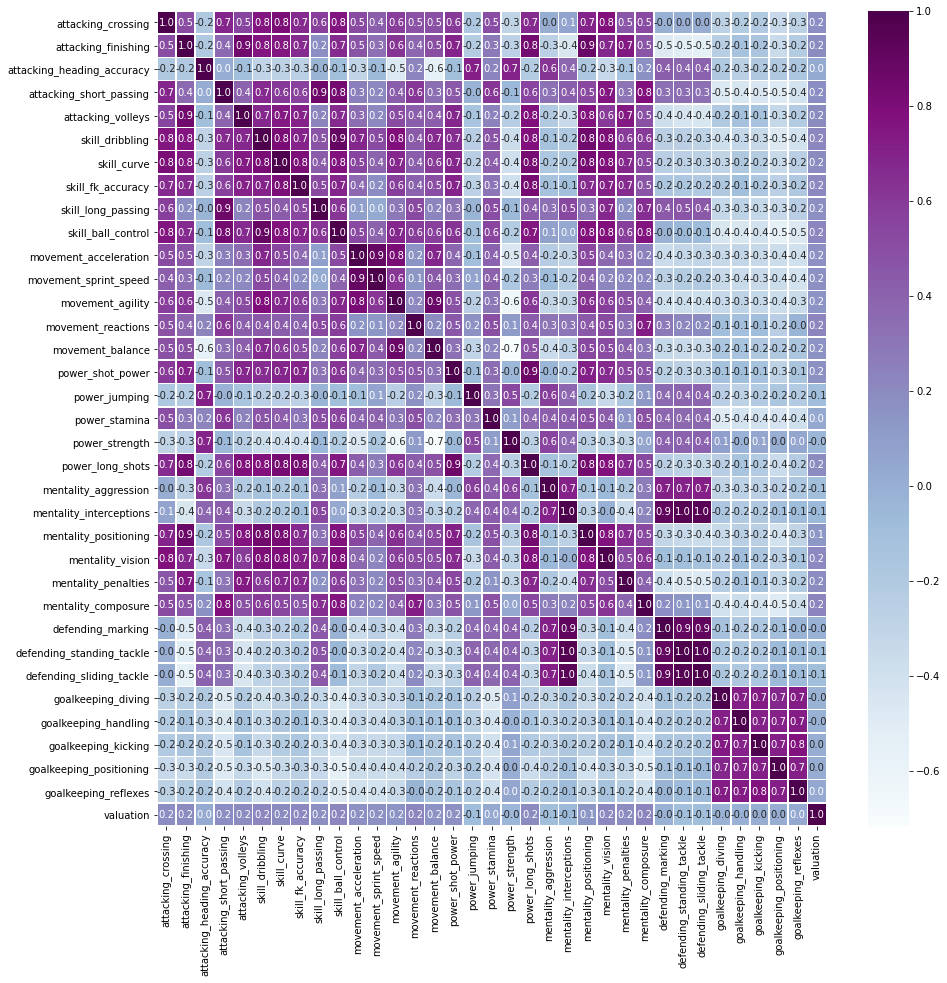

In [44]:
# taking a look at the correlation between attribute scores and a player's valuation: subs
f,ax = plt.subplots(figsize = (15,15))
sns.heatmap(fifa_20_subs.corr(),annot = True,linewidths=.5,fmt = '.1f',ax=ax, cmap="BuPu")
plt.show()

In [45]:
# looking at the moderate to high correlations with p-values < 0.05: subs
corr_df = fifa_20_subs.corr()

def calculate_pvalues(df):
    df = df.dropna()._get_numeric_data()
    dfcols = pd.DataFrame(columns=df.columns)
    pvalues = dfcols.transpose().join(dfcols, how='outer')
    for r in df.columns:
        for c in df.columns:
            pvalues[r][c] = round(stats.pearsonr(df[r], df[c])[1], 4)
    return pvalues

p_value_subs = calculate_pvalues(fifa_20_subs)

sig_df = p_value_subs.loc[p_value_subs['valuation']<.05, ['valuation']]
corr_sig_df = sig_df.merge(corr_df, left_index=True, right_index=True)
corr_sig_df.loc[corr_sig_df["valuation_y"] >= 0.50, ['valuation_y']]

,valuation_y
valuation,1.0


* This gives us a simple picture of what performance attributes correlate with certain playing positions in 2019, where we have the largest sample sizes
* However, tracking the improvements/declines in certain attributes in players over time can help us create a more accurate picture of player performance with a regression

* For the regression, we'll used a hierarchal/mixed-effects model since the scores for the same players yearly over a period of time (longitudinal data) are likely to be correlated

# Mixed-Effects Modeling

In [46]:
# adding a corresponding year to each dataframe for later concatenation of all player/valuation tables
positional_df_list = [fifa_15_attackers, fifa_15_midfielders, fifa_15_defenders, fifa_15_gks, fifa_15_subs, fifa_16_attackers, fifa_16_midfielders,
fifa_16_defenders, fifa_16_gks, fifa_16_subs, fifa_17_attackers, fifa_17_midfielders, fifa_17_defenders, fifa_17_gks, fifa_17_subs, fifa_18_attackers,
fifa_18_midfielders, fifa_18_defenders, fifa_18_gks, fifa_18_subs, fifa_19_attackers, fifa_19_midfielders, fifa_19_defenders, 
fifa_19_gks, fifa_19_subs, fifa_20_attackers, fifa_20_midfielders, fifa_20_defenders, fifa_20_gks, fifa_20_subs]

years = [2015, 2015, 2015, 2015, 2015, 2016, 2016, 2016, 2016, 2016, 2017, 2017, 2017, 2017, 2017, 2018, 2018, 2018, 2018, 2018, 2019, 2019, 2019, 2019, 2019, 2020, 2020, 2020, 2020, 2020]

for df, year in zip(positional_df_list, years):
    df["year"] = year

# taking a look at a table with the added year column
fifa_20_attackers

,name,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,...,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,valuation,year
0,Lionel Messi,88,95,70,92,88,97,93,94,92,...,68,94,48,40,94,94,75,96,171.00,2020
2,Luis Suárez,78,91,83,82,90,85,86,82,72,...,86,86,87,41,92,82,83,85,57.00,2020
4,Antoine Griezmann,83,89,84,85,87,88,86,85,82,...,63,83,73,49,90,86,86,89,148.20,2020
15,Cristiano Ronaldo,84,94,89,83,87,89,81,76,77,...,78,93,63,29,95,82,85,95,102.60,2020
16,Paulo Dybala,82,80,64,87,88,90,88,88,75,...,61,86,48,42,80,87,86,84,98.80,2020
33,Kylian Mbappé,78,89,77,82,79,91,79,63,70,...,76,79,62,38,89,80,70,84,228.00,2020
36,Ángel Di María,86,76,51,83,77,87,88,88,80,...,60,84,73,42,84,86,73,84,45.60,2020
62,Eden Hazard,81,84,61,89,83,95,83,79,83,...,63,80,54,41,87,89,88,91,171.00,2020
67,Karim Benzema,75,84,83,85,83,86,81,73,72,...,80,76,65,39,88,86,82,87,45.60,2020
79,Vinícius Júnior,71,68,50,73,70,86,77,62,67,...,60,68,48,26,76,73,65,77,79.80,2020


In [47]:
# concatenating the tables for the regressions by position
FIFA_new_attackers = pd.concat([fifa_15_attackers, fifa_16_attackers, fifa_17_attackers, fifa_18_attackers, fifa_19_attackers, 
fifa_20_attackers])

FIFA_new_midfielders = pd.concat([fifa_15_midfielders, fifa_16_midfielders, fifa_17_midfielders,
fifa_18_midfielders, fifa_19_midfielders, fifa_20_midfielders])

FIFA_new_defenders = pd.concat([fifa_15_defenders, fifa_16_defenders, fifa_17_defenders, fifa_18_defenders, fifa_19_defenders,
fifa_20_defenders])

FIFA_new_gks = pd.concat([fifa_15_gks, fifa_16_gks, fifa_17_gks, fifa_18_gks, fifa_19_gks,
fifa_20_gks])

FIFA_new_subs = pd.concat([fifa_15_subs, fifa_16_subs, fifa_17_subs, fifa_18_subs, fifa_19_subs,
fifa_20_subs])

# taking a look at the concatenated tables
FIFA_new_attackers
FIFA_new_midfielders
FIFA_new_defenders
FIFA_new_gks
FIFA_new_subs

,name,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,...,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,valuation,year
0,Lionel Messi,84,94,71,89,85,96,89,90,76,...,60,88,48,22,92,90,76,0,136.80,2015
2,Neymar,71,85,62,72,83,94,78,78,72,...,45,70,56,36,87,72,81,0,74.10,2015
4,Rui Patrício,78,80,55,83,70,84,81,57,74,...,52,73,56,49,85,75,66,0,22.80,2015
10,Cristiano Ronaldo,83,95,86,82,87,93,88,79,72,...,79,93,63,24,91,81,85,0,121.60,2015
11,Gareth Bale,84,81,74,84,76,87,87,85,80,...,79,88,77,59,83,79,76,0,91.20,2015
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
428,Ante Rebic,74,79,71,73,82,80,76,58,57,...,83,79,84,29,79,70,63,75,45.60,2020
434,Federico Chiesa,72,70,50,76,68,84,74,48,60,...,60,78,62,30,76,73,62,76,68.40,2020
436,Wesley,58,74,75,76,74,75,57,49,68,...,95,73,83,37,78,71,69,78,21.66,2020
443,Domenico Berardi,74,74,62,75,78,80,70,73,75,...,61,79,85,26,77,71,74,74,25.08,2020


,name,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,...,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,valuation,year
3,Sergio Busquets,62,60,70,85,44,74,66,68,78,...,77,54,86,88,77,85,60,0,48.45,2015
5,Ivan Rakitic,89,80,49,85,80,81,87,84,90,...,63,84,67,61,80,87,78,0,28.50,2015
13,Luka Modric,78,71,55,88,75,86,82,79,86,...,66,82,62,73,79,89,80,0,54.15,2015
14,James Rodríguez,81,80,68,83,81,86,85,83,84,...,73,82,74,58,80,87,81,0,54.15,2015
15,Toni Kroos,86,76,54,91,84,84,88,83,90,...,74,88,54,72,75,88,73,0,48.26,2015
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
435,Marc Roca,66,59,42,83,44,72,66,52,84,...,66,69,69,77,60,80,55,74,28.50,2020
437,Jack Grealish,69,62,36,78,72,80,72,65,71,...,61,72,48,43,71,78,58,77,28.50,2020
449,Riccardo Orsolini,77,64,52,76,72,81,80,68,64,...,62,74,44,40,67,71,56,74,19.95,2020
450,Weston McKennie,57,59,82,76,49,74,56,55,69,...,83,68,82,74,75,75,58,68,22.80,2020


,name,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,...,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,valuation,year
7,Jordi Alba,80,77,64,71,79,93,92,89,83,...,76,82,79,13,15,13,6,13,28.50,2015
12,Sergio Ramos,52,73,64,70,83,79,79,84,82,...,85,89,90,11,8,9,7,11,48.45,2015
18,Marcelo,83,80,67,76,86,79,83,79,85,...,74,79,83,12,5,5,5,9,28.50,2015
20,Dani Olmo,76,75,47,71,79,79,85,86,77,...,78,78,81,13,13,15,9,15,NaN,2015
28,César Azpilicueta,70,66,58,74,75,79,79,75,83,...,79,84,81,13,9,10,6,5,21.66,2015
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
440,Ben Davies,57,44,40,63,62,73,70,61,67,...,74,73,70,6,15,10,15,6,28.50,2020
442,Aarón Martín,75,75,54,67,77,76,69,76,77,...,77,78,77,11,14,10,12,12,20.52,2020
444,Lewis Dunk,60,30,43,74,68,42,50,44,79,...,79,76,78,15,16,9,12,6,18.24,2020
445,Jannik Vestergaard,45,41,52,80,57,34,34,29,73,...,77,82,77,16,11,11,15,10,22.80,2020


,name,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,...,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,valuation,year
24,Thibaut Courtois,25,25,25,31,23,46,52,61,76,...,25,25,25,84,87,69,86,88,28.50,2015
57,Wojciech Szczesny,25,25,25,35,21,50,40,55,76,...,25,25,25,83,79,70,76,84,17.67,2015
62,Hugo Lloris,25,25,25,31,34,65,63,55,84,...,25,25,25,86,81,71,81,88,18.24,2015
99,Rui Patrício,25,25,25,30,25,45,48,56,75,...,25,25,25,83,81,82,78,80,22.80,2015
116,Bernd Leno,25,25,25,33,28,46,52,52,82,...,25,25,25,82,82,81,83,83,20.52,2015
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
308,Pau López,18,23,21,41,16,45,52,40,74,...,19,20,11,82,83,79,82,84,22.80,2020
331,Jordan Pickford,14,18,16,56,40,53,44,55,84,...,21,20,12,82,78,87,82,86,45.60,2020
349,Rui Patrício,20,10,16,30,23,53,57,61,77,...,14,13,11,84,80,77,81,82,22.80,2020
357,Alessio Cragno,13,11,12,25,21,41,37,37,71,...,20,11,12,84,78,69,76,88,19.95,2020


,name,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,...,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,valuation,year
6,Marc-André ter Stegen,25,25,25,30,25,25,25,25,38,...,25,25,25,83,81,82,78,85,20.90,2015
8,Marc Bartra,49,42,74,79,42,59,55,44,72,...,80,81,79,9,14,12,11,7,13.68,2015
9,Sergi Roberto,61,64,48,85,45,73,71,60,75,...,47,56,49,13,15,10,14,9,9.12,2015
17,Isco,72,76,61,87,59,86,84,74,79,...,25,23,26,10,8,12,15,6,39.90,2015
19,Raphaël Varane,36,40,84,73,42,57,46,54,74,...,80,84,83,11,11,9,5,14,27.93,2015
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
429,Evan N'Dicka,47,35,78,70,28,58,23,30,66,...,77,75,73,13,8,7,8,8,26.22,2020
431,Danny Rose,55,54,50,66,55,57,61,59,61,...,62,59,57,8,16,10,10,7,28.50,2020
432,Steven Nzonzi,59,50,78,82,55,70,70,40,71,...,79,79,74,7,16,16,16,13,23.94,2020
439,Arne Maier,64,54,32,81,39,74,49,44,77,...,75,73,63,14,10,10,8,7,26.22,2020


In [48]:
# taking a look at the sample size for each of the concatenated tables, with random effects/grouping on player ("name") in mind
len(FIFA_new_attackers)
len(FIFA_new_midfielders)
len(FIFA_new_defenders)
len(FIFA_new_gks)
len(FIFA_new_subs)

286

602

407

81

801

In [49]:
# using mixed-level modeling (mixedlm from statsmodels) on positional tables: attackers
FIFA_new_attackers = FIFA_new_attackers.dropna()
data_attackers = FIFA_new_attackers
model_attackers = smf.mixedlm('valuation~attacking_crossing+attacking_finishing+attacking_heading_accuracy+attacking_short_passing+attacking_volleys+skill_dribbling+skill_curve+skill_fk_accuracy+skill_long_passing+skill_ball_control+movement_acceleration+movement_sprint_speed+movement_agility+movement_reactions+movement_balance+power_shot_power+power_jumping+power_stamina+power_strength+power_long_shots+mentality_aggression+mentality_interceptions+mentality_positioning+mentality_vision+mentality_penalties+mentality_composure', data_attackers, groups=data_attackers['name'])
mdf_attackers = model_attackers.fit()

# taking a look at the model fit summary
mdf_attackers.summary()

<class 'statsmodels.iolib.summary2.Summary'>
"""
                   Mixed Linear Model Regression Results
============================================================================
Model:                    MixedLM       Dependent Variable:       valuation 
No. Observations:         286           Method:                   REML      
No. Groups:               128           Scale:                    356.0380  
Min. group size:          1             Log-Likelihood:           -1302.6585
Max. group size:          8             Converged:                Yes       
Mean group size:          2.2                                               
----------------------------------------------------------------------------
                            Coef.   Std.Err.    z    P>|z|  [0.025   0.975] 
----------------------------------------------------------------------------
Intercept                  -373.935   36.568 -10.226 0.000 -445.607 -302.263
attacking_crossing            0.093    0.322   0.289 0.773   -0.538    0.723
attacking_finishing           0.777    0.440   1.767 0.077   -0.085    1.638
attacking_heading_accuracy    0.730    0.255   2.861 0.004    0.230    1.231
attacking_short_passing       1.048    0.554   1.892 0.058   -0.037    2.134
attacking_volleys            -0.019    0.348  -0.056 0.956   -0.702    0.663
skill_dribbling               0.375    0.667   0.562 0.574   -0.932    1.682
skill_curve                  -0.167    0.294  -0.568 0.570   -0.744    0.410
skill_fk_accuracy            -0.268    0.230  -1.166 0.244   -0.718    0.182
skill_long_passing            0.278    0.279   0.994 0.320   -0.270    0.825
skill_ball_control            0.152    0.771   0.197 0.844   -1.359    1.663
movement_acceleration         0.155    0.529   0.292 0.770   -0.883    1.192
movement_sprint_speed         0.016    0.488   0.032 0.975   -0.941    0.972
movement_agility              0.709    0.448   1.585 0.113   -0.168    1.587
movement_reactions            0.573    0.526   1.089 0.276   -0.458    1.604
movement_balance              0.074    0.248   0.298 0.766   -0.412    0.559
power_shot_power              0.687    0.494   1.392 0.164   -0.280    1.654
power_jumping                -0.220    0.241  -0.914 0.361   -0.693    0.252
power_stamina                 0.386    0.287   1.345 0.179   -0.176    0.948
power_strength                0.038    0.264   0.144 0.886   -0.479    0.555
power_long_shots             -0.361    0.448  -0.805 0.421   -1.238    0.517
mentality_aggression         -0.317    0.169  -1.872 0.061   -0.648    0.015
mentality_interceptions      -0.405    0.183  -2.211 0.027   -0.765   -0.046
mentality_positioning         0.228    0.644   0.353 0.724   -1.035    1.491
mentality_vision              0.320    0.452   0.709 0.478   -0.565    1.205
mentality_penalties           0.164    0.257   0.637 0.524   -0.341    0.668
mentality_composure           0.108    0.045   2.417 0.016    0.020    0.195
Group Var                   295.200    4.620                                
============================================================================

"""

In [50]:
# using mixed-level modeling (mixedlm from statsmodels) on positional tables: midfielders
FIFA_new_midfielders = FIFA_new_midfielders.dropna()
data_midfielders = FIFA_new_midfielders
model_midfielders = smf.mixedlm('valuation~attacking_crossing+attacking_finishing+attacking_heading_accuracy+attacking_short_passing+attacking_volleys+skill_dribbling+skill_curve+skill_fk_accuracy+skill_long_passing+skill_ball_control+movement_acceleration+movement_sprint_speed+movement_agility+movement_reactions+movement_balance+power_shot_power+power_jumping+power_stamina+power_strength+power_long_shots+mentality_aggression+mentality_interceptions+mentality_positioning+mentality_vision+mentality_penalties+mentality_composure', data_midfielders, groups=data_midfielders['name'])
mdf_midfielders = model_midfielders.fit()

# taking a look at the model fit summary
mdf_midfielders.summary()

<class 'statsmodels.iolib.summary2.Summary'>
"""
                   Mixed Linear Model Regression Results
============================================================================
Model:                    MixedLM       Dependent Variable:       valuation 
No. Observations:         598           Method:                   REML      
No. Groups:               220           Scale:                    176.1064  
Min. group size:          1             Log-Likelihood:           -2558.5492
Max. group size:          7             Converged:                Yes       
Mean group size:          2.7                                               
----------------------------------------------------------------------------
                            Coef.   Std.Err.    z    P>|z|  [0.025   0.975] 
----------------------------------------------------------------------------
Intercept                  -185.919   17.803 -10.443 0.000 -220.813 -151.025
attacking_crossing           -0.094    0.163  -0.577 0.564   -0.413    0.225
attacking_finishing           0.163    0.167   0.972 0.331   -0.165    0.491
attacking_heading_accuracy    0.256    0.121   2.118 0.034    0.019    0.493
attacking_short_passing      -0.054    0.358  -0.152 0.879   -0.756    0.647
attacking_volleys             0.027    0.136   0.196 0.845   -0.240    0.293
skill_dribbling              -0.009    0.287  -0.031 0.975   -0.572    0.554
skill_curve                  -0.049    0.151  -0.324 0.746   -0.344    0.247
skill_fk_accuracy             0.250    0.128   1.948 0.051   -0.002    0.501
skill_long_passing            0.259    0.218   1.184 0.236   -0.169    0.686
skill_ball_control            1.096    0.415   2.640 0.008    0.282    1.909
movement_acceleration        -0.060    0.233  -0.259 0.796   -0.518    0.397
movement_sprint_speed        -0.058    0.194  -0.302 0.763   -0.438    0.321
movement_agility              0.027    0.198   0.137 0.891   -0.360    0.414
movement_reactions            1.115    0.233   4.775 0.000    0.657    1.572
movement_balance              0.198    0.142   1.394 0.163   -0.080    0.476
power_shot_power             -0.364    0.190  -1.914 0.056   -0.736    0.009
power_jumping                -0.131    0.102  -1.289 0.198   -0.331    0.068
power_stamina                 0.186    0.143   1.303 0.193   -0.094    0.465
power_strength                0.183    0.135   1.354 0.176   -0.082    0.447
power_long_shots              0.224    0.179   1.249 0.212   -0.128    0.576
mentality_aggression          0.257    0.107   2.414 0.016    0.048    0.466
mentality_interceptions      -0.273    0.092  -2.961 0.003   -0.454   -0.092
mentality_positioning        -0.261    0.209  -1.248 0.212   -0.671    0.149
mentality_vision             -0.214    0.244  -0.876 0.381   -0.691    0.264
mentality_penalties           0.123    0.128   0.963 0.336   -0.127    0.373
mentality_composure           0.105    0.020   5.165 0.000    0.065    0.145
Group Var                   216.431    2.947                                
============================================================================

"""

In [51]:
# using mixed-level modeling (mixedlm from statsmodels) on positional tables: defenders
FIFA_new_defenders = FIFA_new_defenders.dropna()
data_defenders = FIFA_new_defenders
model_defenders = smf.mixedlm('valuation~skill_dribbling+skill_curve+skill_fk_accuracy+skill_long_passing+skill_ball_control+movement_acceleration+movement_sprint_speed+movement_agility+movement_reactions+movement_balance+power_shot_power+power_jumping+power_stamina+power_strength+power_long_shots+mentality_aggression+mentality_interceptions+mentality_positioning+mentality_vision+mentality_penalties+mentality_composure+defending_marking+defending_standing_tackle+defending_sliding_tackle+goalkeeping_diving+goalkeeping_handling+goalkeeping_kicking+goalkeeping_positioning+goalkeeping_reflexes', data_defenders, groups=data_defenders['name'])
mdf_defenders = model_defenders.fit()

# taking a look at the model fit summary
mdf_defenders.summary()

<class 'statsmodels.iolib.summary2.Summary'>
"""
                  Mixed Linear Model Regression Results
=========================================================================
Model:                   MixedLM      Dependent Variable:      valuation 
No. Observations:        403          Method:                  REML      
No. Groups:              123          Scale:                   117.9357  
Min. group size:         1            Log-Likelihood:          -1612.8027
Max. group size:         10           Converged:               Yes       
Mean group size:         3.3                                             
-------------------------------------------------------------------------
                           Coef.   Std.Err.   z    P>|z|  [0.025   0.975]
-------------------------------------------------------------------------
Intercept                 -116.057   18.875 -6.149 0.000 -153.051 -79.063
skill_dribbling             -0.087    0.147 -0.592 0.554   -0.375   0.201
skill_curve                  0.173    0.118  1.459 0.145   -0.059   0.405
skill_fk_accuracy           -0.022    0.102 -0.219 0.827   -0.221   0.177
skill_long_passing           0.060    0.149  0.402 0.688   -0.233   0.353
skill_ball_control          -0.226    0.200 -1.128 0.260   -0.618   0.167
movement_acceleration       -0.210    0.203 -1.032 0.302   -0.609   0.189
movement_sprint_speed        0.264    0.175  1.511 0.131   -0.079   0.606
movement_agility             0.077    0.148  0.517 0.605   -0.214   0.367
movement_reactions           0.831    0.218  3.808 0.000    0.403   1.258
movement_balance            -0.324    0.138 -2.339 0.019   -0.595  -0.053
power_shot_power            -0.164    0.119 -1.376 0.169   -0.398   0.070
power_jumping                0.211    0.104  2.027 0.043    0.007   0.416
power_stamina                0.048    0.142  0.340 0.734   -0.231   0.328
power_strength              -0.104    0.151 -0.689 0.491   -0.400   0.192
power_long_shots             0.089    0.100  0.888 0.374   -0.108   0.286
mentality_aggression         0.126    0.145  0.869 0.385   -0.158   0.411
mentality_interceptions      0.135    0.259  0.520 0.603   -0.373   0.642
mentality_positioning        0.003    0.121  0.028 0.978   -0.234   0.241
mentality_vision             0.289    0.120  2.414 0.016    0.054   0.523
mentality_penalties         -0.120    0.115 -1.046 0.295   -0.346   0.105
mentality_composure          0.106    0.023  4.703 0.000    0.062   0.150
defending_marking            0.274    0.228  1.200 0.230   -0.174   0.722
defending_standing_tackle    0.739    0.326  2.269 0.023    0.101   1.377
defending_sliding_tackle    -0.235    0.288 -0.816 0.414   -0.800   0.329
goalkeeping_diving          -0.969    0.340 -2.846 0.004   -1.636  -0.302
goalkeeping_handling         0.691    0.314  2.200 0.028    0.075   1.306
goalkeeping_kicking         -0.386    0.348 -1.108 0.268   -1.068   0.297
goalkeeping_positioning      0.161    0.304  0.529 0.597   -0.434   0.756
goalkeeping_reflexes        -0.067    0.315 -0.213 0.832   -0.685   0.551
Group Var                   74.634    1.850                              
=========================================================================

"""

In [52]:
# using mixed-level modeling (mixedlm from statsmodels) on positional tables: gks
FIFA_new_gks = FIFA_new_gks.dropna()
data_gks = FIFA_new_gks
model_gks = smf.mixedlm('valuation~skill_dribbling+skill_curve+skill_fk_accuracy+skill_long_passing+skill_ball_control+movement_acceleration+movement_sprint_speed+movement_agility+movement_reactions+movement_balance+power_shot_power+power_jumping+power_stamina+power_strength+power_long_shots+mentality_aggression+mentality_interceptions+mentality_positioning+mentality_vision+mentality_penalties+mentality_composure+defending_marking+defending_standing_tackle+defending_sliding_tackle+goalkeeping_diving+goalkeeping_handling+goalkeeping_kicking+goalkeeping_positioning+goalkeeping_reflexes', data_gks, groups=data_gks['name'])
mdf_gks = model_gks.fit()

# taking a look at the model fit summary
mdf_gks.summary()

<class 'statsmodels.iolib.summary2.Summary'>
"""
                 Mixed Linear Model Regression Results
========================================================================
Model:                   MixedLM      Dependent Variable:      valuation
No. Observations:        81           Method:                  REML     
No. Groups:              19           Scale:                   103.0934 
Min. group size:         3            Log-Likelihood:          -306.0804
Max. group size:         6            Converged:               Yes      
Mean group size:         4.3                                            
------------------------------------------------------------------------
                           Coef.   Std.Err.   z    P>|z|  [0.025  0.975]
------------------------------------------------------------------------
Intercept                 -108.368   73.276 -1.479 0.139 -251.986 35.250
skill_dribbling              0.474    0.919  0.516 0.606   -1.327  2.274
skill_curve                 -1.036    1.245 -0.832 0.405   -3.477  1.405
skill_fk_accuracy            0.071    1.016  0.070 0.944   -1.921  2.063
skill_long_passing           0.232    0.292  0.794 0.427   -0.341  0.805
skill_ball_control           1.733    0.687  2.522 0.012    0.386  3.079
movement_acceleration       -3.019    0.917 -3.292 0.001   -4.817 -1.221
movement_sprint_speed        1.863    0.894  2.085 0.037    0.112  3.615
movement_agility            -0.012    0.528 -0.023 0.981   -1.047  1.022
movement_reactions           1.012    0.662  1.527 0.127   -0.287  2.310
movement_balance             0.863    0.622  1.389 0.165   -0.355  2.081
power_shot_power             0.304    0.112  2.712 0.007    0.084  0.525
power_jumping               -0.762    0.308 -2.474 0.013   -1.365 -0.158
power_stamina               -0.194    0.609 -0.318 0.750   -1.386  0.999
power_strength              -0.150    0.512 -0.293 0.770   -1.154  0.854
power_long_shots             1.962    1.662  1.180 0.238   -1.296  5.220
mentality_aggression        -0.508    0.441 -1.153 0.249   -1.372  0.356
mentality_interceptions     -2.372    0.814 -2.914 0.004   -3.967 -0.777
mentality_positioning       -1.290    0.986 -1.308 0.191   -3.223  0.643
mentality_vision            -0.078    0.219 -0.358 0.720   -0.507  0.350
mentality_penalties          0.416    0.490  0.849 0.396   -0.544  1.377
mentality_composure          0.056    0.103  0.541 0.589   -0.147  0.259
defending_marking            0.772    0.330  2.340 0.019    0.125  1.418
defending_standing_tackle   -0.187    1.569 -0.119 0.905   -3.262  2.889
defending_sliding_tackle    -0.446    0.979 -0.456 0.648   -2.364  1.472
goalkeeping_diving           1.644    1.067  1.541 0.123   -0.447  3.736
goalkeeping_handling        -0.877    0.787 -1.113 0.266   -2.420  0.667
goalkeeping_kicking          0.516    0.519  0.994 0.320   -0.501  1.532
goalkeeping_positioning      0.933    0.776  1.202 0.229   -0.588  2.453
goalkeeping_reflexes        -0.590    1.087 -0.543 0.587   -2.720  1.540
Group Var                  258.622   19.953                             
========================================================================

"""

In [53]:
# using mixed-level modeling (mixedlm from statsmodels) on positional tables: subs
FIFA_new_subs = FIFA_new_subs.dropna()
data_subs = FIFA_new_subs
model_subs = smf.mixedlm('valuation~attacking_crossing+attacking_finishing+attacking_heading_accuracy+attacking_short_passing+attacking_volleys+skill_dribbling+skill_curve+skill_fk_accuracy+skill_long_passing+skill_ball_control+movement_acceleration+movement_sprint_speed+movement_agility+movement_reactions+movement_balance+power_shot_power+power_jumping+power_stamina+power_strength+power_long_shots+mentality_aggression+mentality_interceptions+mentality_positioning+mentality_vision+mentality_penalties+mentality_composure', data_subs, groups=data_subs['name'])
mdf_subs = model_subs.fit()

# taking a look at the model fit summary
mdf_subs.summary()

<class 'statsmodels.iolib.summary2.Summary'>
"""
                 Mixed Linear Model Regression Results
========================================================================
Model:                  MixedLM      Dependent Variable:      valuation 
No. Observations:       794          Method:                  REML      
No. Groups:             349          Scale:                   122.8692  
Min. group size:        1            Log-Likelihood:          -3217.5570
Max. group size:        9            Converged:               Yes       
Mean group size:        2.3                                             
------------------------------------------------------------------------
                            Coef.  Std.Err.   z    P>|z|  [0.025  0.975]
------------------------------------------------------------------------
Intercept                  -66.379    7.855 -8.451 0.000 -81.774 -50.984
attacking_crossing          -0.042    0.075 -0.567 0.571  -0.188   0.104
attacking_finishing          0.002    0.098  0.025 0.980  -0.190   0.195
attacking_heading_accuracy   0.118    0.068  1.739 0.082  -0.015   0.251
attacking_short_passing      0.303    0.153  1.981 0.048   0.003   0.602
attacking_volleys            0.022    0.076  0.291 0.771  -0.127   0.171
skill_dribbling              0.113    0.126  0.898 0.369  -0.133   0.359
skill_curve                  0.123    0.080  1.536 0.125  -0.034   0.280
skill_fk_accuracy           -0.028    0.069 -0.402 0.688  -0.164   0.108
skill_long_passing          -0.007    0.110 -0.064 0.949  -0.222   0.208
skill_ball_control          -0.365    0.144 -2.532 0.011  -0.647  -0.082
movement_acceleration       -0.129    0.141 -0.914 0.361  -0.404   0.147
movement_sprint_speed        0.091    0.128  0.707 0.479  -0.161   0.342
movement_agility            -0.079    0.097 -0.816 0.415  -0.268   0.110
movement_reactions           0.885    0.083 10.713 0.000   0.723   1.047
movement_balance             0.234    0.086  2.711 0.007   0.065   0.404
power_shot_power             0.013    0.089  0.146 0.884  -0.161   0.187
power_jumping               -0.015    0.064 -0.241 0.809  -0.140   0.110
power_stamina               -0.018    0.086 -0.206 0.837  -0.186   0.150
power_strength               0.195    0.074  2.630 0.009   0.050   0.341
power_long_shots            -0.014    0.095 -0.147 0.883  -0.200   0.172
mentality_aggression        -0.103    0.063 -1.638 0.101  -0.225   0.020
mentality_interceptions     -0.075    0.055 -1.367 0.172  -0.183   0.033
mentality_positioning       -0.148    0.093 -1.592 0.111  -0.331   0.034
mentality_vision             0.088    0.086  1.029 0.304  -0.080   0.257
mentality_penalties         -0.051    0.076 -0.666 0.505  -0.200   0.099
mentality_composure          0.111    0.016  6.973 0.000   0.080   0.142
Group Var                   80.112    1.431                             
========================================================================

"""

# Testing the Model

* Now that we have some models based on type of player (ie position), let's take a look players that are currently not in the top 500 (and weren't used to fit the model) to see what their model-predicted values are
* Depending on the predicted values of the model, players that are currently undervalued according to their skillset may rise in the ranks and enter the top players (high-value players) in the future

In [54]:
# loading the FIFA data for current non-high value players and setting an age limit
fifa_20_new_players = pd.read_csv('project data/new_players_20.csv')
fifa_20_new_players = fifa_20_new_players[fifa_20_new_players['age'] < 23]

# taking a look at the loaded table
fifa_20_new_players


,Unnamed: 0,short_name,name,age,height_cm,weight_kg,nationality,club,overall,potential,...,mentality_penalties,mentality_composure,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes
37,166,L. Jović,Luka Jović,21.0,182.0,85.0,Serbia,Real Madrid,83.0,89.0,...,66.0,79.0,25.0,26.0,16.0,8.0,7.0,12.0,9.0,13.0
103,340,T. Ndombele,Tanguy NDombèlé Alvaro,22.0,181.0,76.0,France,Tottenham Hotspur,81.0,89.0,...,60.0,87.0,68.0,74.0,69.0,8.0,10.0,13.0,8.0,7.0
152,437,Melendo,Óscar Melendo Jiménez,21.0,167.0,63.0,Spain,RCD Espanyol,80.0,86.0,...,37.0,66.0,58.0,58.0,53.0,9.0,7.0,13.0,15.0,8.0
255,585,A. Lafont,Alban Lafont,20.0,193.0,82.0,France,FC Nantes,79.0,88.0,...,16.0,59.0,20.0,14.0,12.0,80.0,77.0,71.0,76.0,83.0
260,600,V. Tsygankov,Viktor Tsygankov,21.0,177.0,69.0,Ukraine,Dynamo Kyiv,79.0,86.0,...,71.0,78.0,66.0,36.0,37.0,9.0,7.0,15.0,6.0,12.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17811,18272,P. Martin,Paul Martin,20.0,188.0,84.0,Republic of Ireland,Waterford FC,48.0,58.0,...,13.0,34.0,6.0,12.0,11.0,54.0,51.0,46.0,43.0,45.0
17812,18273,Shao Shuai,邵帅,22.0,186.0,79.0,China PR,Beijing Renhe FC,48.0,56.0,...,39.0,41.0,45.0,50.0,52.0,5.0,5.0,13.0,5.0,14.0
17813,18274,Xiao Mingjie,Mingjie Xiao,22.0,177.0,66.0,China PR,Shanghai SIPG FC,48.0,56.0,...,37.0,35.0,42.0,53.0,57.0,13.0,6.0,14.0,11.0,9.0
17814,18275,Zhang Wei,张威,19.0,186.0,75.0,China PR,Hebei China Fortune FC,48.0,56.0,...,36.0,39.0,46.0,52.0,46.0,7.0,8.0,10.0,6.0,14.0


In [55]:
# separating the new players by position before passing them through the position-specific models
fifa_20_new_players_attackers = fifa_20_new_players[fifa_20_new_players['team_position'].isin(['ST', 'LW', 'RW', 'CF', 'LF', 'RF', 'LS', 'RS'])]
fifa_20_new_players_midfielders = fifa_20_new_players[fifa_20_new_players['team_position'].isin(['LCM', 'RCM', 'CAM', 'CDM', 'LDM', 'RDM', 'RM', 'LM', 'LAM', 'RAM', 'CM', 'RWB', 'LWB'])]
fifa_20_new_players_defenders = fifa_20_new_players[fifa_20_new_players['team_position'].isin(['LCB', 'RCB', 'LB', 'RB', 'CB'])]
fifa_20_new_players_gks = fifa_20_new_players[fifa_20_new_players['team_position'].isin(['GK'])]
fifa_20_new_players_subs = fifa_20_new_players[fifa_20_new_players['team_position'].isin(['SUB'])]

In [56]:
# restricting the new players tables to the columns used by the performance models
new_attackers_columns_list = [
 'name',
 'age',
 'attacking_crossing', 
 'attacking_finishing',
 'attacking_heading_accuracy',
 'attacking_short_passing',
 'attacking_volleys',
 'skill_dribbling',
 'skill_curve',
 'skill_fk_accuracy',
 'skill_long_passing',
 'skill_ball_control',
 'movement_acceleration',
 'movement_sprint_speed',
 'movement_agility',
 'movement_reactions',
 'movement_balance',
 'power_shot_power',
 'power_jumping',
 'power_stamina',
 'power_strength',
 'power_long_shots',
 'mentality_aggression',
 'mentality_interceptions',
 'mentality_positioning',
 'mentality_vision',
 'mentality_penalties',
 'mentality_composure']


new_defenders_columns_list = [
 'name',
 'skill_dribbling',
 'skill_curve',
 'skill_fk_accuracy',
 'skill_long_passing',
 'skill_ball_control',
 'movement_acceleration',
 'movement_sprint_speed',
 'movement_agility',
 'movement_reactions',
 'movement_balance',
 'power_shot_power',
 'power_jumping',
 'power_stamina',
 'power_strength',
 'power_long_shots',
 'mentality_aggression',
 'mentality_interceptions',
 'mentality_positioning',
 'mentality_vision',
 'mentality_penalties',
 'mentality_composure',
 'defending_marking',
 'defending_standing_tackle',
 'defending_sliding_tackle',
 'goalkeeping_diving',
 'goalkeeping_handling',
 'goalkeeping_kicking',
 'goalkeeping_positioning',
 'goalkeeping_reflexes']

new_subs_columns_list = [
 'name',
 'attacking_crossing', 
 'attacking_finishing',
 'attacking_heading_accuracy',
 'attacking_short_passing',
 'attacking_volleys',
 'skill_dribbling',
 'skill_curve',
 'skill_fk_accuracy',
 'skill_long_passing',
 'skill_ball_control',
 'movement_acceleration',
 'movement_sprint_speed',
 'movement_agility',
 'movement_reactions',
 'movement_balance',
 'power_shot_power',
 'power_jumping',
 'power_stamina',
 'power_strength',
 'power_long_shots',
 'mentality_aggression',
 'mentality_interceptions',
 'mentality_positioning',
 'mentality_vision',
 'mentality_penalties',
 'mentality_composure',
 'defending_marking',
 'defending_standing_tackle',
 'defending_sliding_tackle',
 'goalkeeping_diving',
 'goalkeeping_handling',
 'goalkeeping_kicking',
 'goalkeeping_positioning',
 'goalkeeping_reflexes']

fifa_20_new_players_attackers = fifa_20_new_players_attackers[new_attackers_columns_list]
fifa_20_new_players_midfielders = fifa_20_new_players_midfielders[new_attackers_columns_list]
fifa_20_new_players_defenders = fifa_20_new_players_defenders[new_defenders_columns_list]
fifa_20_new_players_gks = fifa_20_new_players_gks[new_defenders_columns_list]
fifa_20_new_players_subs = fifa_20_new_players_subs[new_subs_columns_list]

* A way to find players that may become top 500 player in the future is to look at the current cut-off in the top 500 (lowest value) for each position and see if the model estimates of any new players are above the cut-off
* It is a way to find players that may be undervalued, and thus, poised for growth

In [57]:
fifa_20_attackers.sort_values(by='valuation')
fifa_20_midfielders.sort_values(by='valuation')
fifa_20_defenders.sort_values(by='valuation')
fifa_20_gks.sort_values(by='valuation')
fifa_20_subs.sort_values(by='valuation')

,name,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,...,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,valuation,year
427,Milot Rashica,73,78,52,74,76,84,74,68,67,...,58,77,67,39,75,68,65,74,15.39,2020
436,Wesley,58,74,75,76,74,75,57,49,68,...,95,73,83,37,78,71,69,78,21.66,2020
447,Nikola Vlasic,71,69,65,76,66,83,66,58,72,...,66,69,63,26,72,78,66,77,22.80,2020
415,Joshua King,65,81,68,74,73,81,70,53,64,...,77,76,69,34,80,74,81,77,22.80,2020
385,Ayoze Pérez,56,80,75,75,77,82,79,60,51,...,54,65,70,49,83,74,73,73,22.80,2020
380,Jamie Vardy,68,85,78,67,81,74,65,57,48,...,68,64,87,49,86,72,83,81,22.80,2020
340,Dominic Calvert-Lewin,65,70,81,70,65,76,59,54,44,...,81,63,73,34,77,64,72,69,22.80,2020
147,Rui Patrício,78,78,55,80,70,84,81,57,71,...,47,79,56,49,82,78,66,77,22.80,2020
392,Wout Weghorst,42,84,87,76,79,65,40,37,48,...,86,66,76,34,85,65,77,80,23.56,2020
443,Domenico Berardi,74,74,62,75,78,80,70,73,75,...,61,79,85,26,77,71,74,74,25.08,2020


,name,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,...,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,valuation,year
370,Martin Ødegaard,86,64,52,82,68,86,78,79,76,...,40,75,41,48,62,84,63,78,16.34,2020
188,Scott McTominay,68,60,76,78,59,73,64,34,77,...,82,66,78,75,65,72,59,76,18.24,2020
420,Jonathan Ikoné,68,70,39,73,57,81,78,72,65,...,53,68,65,27,75,79,66,79,19.38,2020
449,Riccardo Orsolini,77,64,52,76,72,81,80,68,64,...,62,74,44,40,67,71,56,74,19.95,2020
391,Jérôme Roussillon,85,63,72,78,57,80,75,56,72,...,76,65,75,78,71,73,51,77,19.95,2020
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
165,Philippe Coutinho,79,77,48,84,78,90,90,86,82,...,61,88,59,49,84,86,70,77,108.30,2020
176,Paul Pogba,80,75,75,86,84,87,85,82,90,...,89,82,78,64,83,88,83,87,108.30,2020
143,N'Golo Kanté,68,65,54,86,56,79,49,49,81,...,73,63,90,92,72,79,54,85,114.00,2020
83,Kevin De Bruyne,93,82,55,92,82,86,85,83,91,...,74,90,76,61,88,94,79,91,148.20,2020


,name,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,...,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,valuation,year
364,Benoît Badiashile,43,37,34,52,61,53,54,42,59,...,65,68,62,8,7,5,15,8,13.68,2020
444,Lewis Dunk,60,30,43,74,68,42,50,44,79,...,79,76,78,15,16,9,12,6,18.24,2020
423,Sergio Reguilón,73,70,43,65,74,79,78,75,75,...,77,75,74,11,14,9,5,12,19.76,2020
388,Caglar Söyüncü,57,39,37,55,59,63,63,64,67,...,69,82,79,6,7,7,7,7,19.95,2020
375,Nicolas N'Koulou,68,37,28,70,72,70,70,66,78,...,82,83,78,6,7,6,15,7,19.95,2020
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
69,Raphaël Varane,55,46,52,76,77,79,86,63,83,...,87,86,85,11,11,9,5,14,79.80,2020
88,Aymeric Laporte,63,61,69,80,77,61,66,59,87,...,88,89,88,10,11,5,14,5,85.50,2020
116,Kalidou Koulibaly,69,28,28,63,71,69,73,52,86,...,91,90,87,7,11,7,13,5,85.50,2020
106,Andrew Robertson,78,78,30,71,81,83,86,78,84,...,81,83,80,11,8,10,7,14,91.20,2020


,name,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,...,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,valuation,year
419,Mike Maignan,22,14,16,27,24,47,46,39,79,...,14,12,19,78,77,78,78,83,19.57,2020
357,Alessio Cragno,13,11,12,25,21,41,37,37,71,...,20,11,12,84,78,69,76,88,19.95,2020
349,Rui Patrício,20,10,16,30,23,53,57,61,77,...,14,13,11,84,80,77,81,82,22.80,2020
308,Pau López,18,23,21,41,16,45,52,40,74,...,19,20,11,82,83,79,82,84,22.80,2020
242,Thomas Strakosha,14,14,12,22,15,41,46,45,74,...,20,18,12,84,78,75,79,87,22.80,2020
256,Anthony Lopes,15,15,14,31,21,63,64,67,84,...,13,15,13,87,80,75,84,89,28.50,2020
126,Alex Meret,16,20,21,22,22,41,48,37,74,...,10,21,12,79,74,70,77,82,28.50,2020
129,Hugo Lloris,10,11,10,50,34,65,62,55,86,...,29,10,18,89,82,68,84,91,28.50,2020
218,Bernd Leno,16,9,8,42,30,55,56,52,79,...,27,15,18,83,81,78,84,85,34.20,2020
267,André Onana,26,30,17,26,38,64,62,68,80,...,12,18,14,84,80,86,76,83,39.90,2020


,name,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,...,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,valuation,year
46,Colin Dagba,72,38,54,75,39,76,61,41,64,...,69,70,71,7,6,9,11,11,13.30,2020
239,Kang-in Lee,70,70,45,74,60,80,78,81,72,...,26,23,23,11,12,12,8,14,14.25,2020
263,Jeff Reine-Adélaïde,65,67,58,72,63,81,61,53,64,...,26,64,49,10,15,11,16,8,16.53,2020
253,Rafael Leão,62,76,58,67,65,77,72,58,52,...,25,24,21,10,12,15,11,9,18.62,2020
424,Jules Koundé,26,29,78,69,32,57,41,26,59,...,78,79,77,11,10,8,14,13,19.76,2020
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91,Rodri,63,64,75,85,59,76,65,54,82,...,82,84,78,10,10,7,14,8,79.80,2020
98,Gabriel Jesus,66,84,75,76,72,86,76,54,66,...,53,23,19,13,8,6,6,15,79.80,2020
20,Matthijs de Ligt,52,50,85,76,40,66,48,55,74,...,86,82,80,12,11,11,12,10,82.65,2020
90,Leroy Sané,83,81,72,80,85,88,83,82,64,...,36,32,35,8,12,9,9,14,114.00,2020


The cut-offs for the following positions are:
* attackers: 15.39 mn
* midfielders: 16.34 mn
* defenders: 13.68 mn
* gks: 19.57 mn
* subs: 13.30 mn

In [58]:
# passing the new players tables throught the model: attackers
fifa_20_new_players_attackers['predicted_values'] = mdf_attackers.predict(fifa_20_new_players_attackers)

# taking a look at model's highest predicted values/players: attackers
x = fifa_20_new_players_attackers[fifa_20_new_players_attackers.predicted_values > 15.39].sort_values(by='predicted_values', ascending = False).iloc[0:11]
x

,name,age,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,...,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,predicted_values
856,Fedor Chalov,21.0,58.0,79.0,67.0,73.0,72.0,74.0,56.0,38.0,...,76.0,67.0,64.0,36.0,44.0,78.0,71.0,74.0,82.0,45.001917
3032,Adama Diakhaby,22.0,65.0,71.0,72.0,72.0,61.0,76.0,54.0,39.0,...,59.0,58.0,61.0,32.0,14.0,71.0,63.0,71.0,63.0,42.142035
2237,Johannes Eggestein,21.0,65.0,75.0,67.0,73.0,66.0,76.0,60.0,42.0,...,67.0,58.0,60.0,37.0,37.0,76.0,67.0,65.0,69.0,38.763909
2248,David Okereke,21.0,43.0,74.0,68.0,70.0,56.0,76.0,40.0,31.0,...,69.0,66.0,56.0,48.0,17.0,70.0,68.0,62.0,71.0,35.414566
1272,Marcus Thuram,21.0,66.0,73.0,73.0,74.0,66.0,81.0,56.0,30.0,...,73.0,86.0,70.0,53.0,45.0,73.0,69.0,63.0,69.0,34.255371
1224,Emmanuel Dennis,21.0,70.0,75.0,74.0,63.0,61.0,78.0,62.0,41.0,...,74.0,59.0,66.0,73.0,13.0,65.0,58.0,56.0,67.0,29.352045
854,Donyell Malen,20.0,66.0,78.0,67.0,69.0,72.0,81.0,63.0,57.0,...,76.0,74.0,67.0,60.0,31.0,67.0,65.0,60.0,69.0,29.070103
1212,Yann Karamoh,20.0,67.0,68.0,65.0,73.0,66.0,82.0,67.0,44.0,...,72.0,61.0,70.0,50.0,29.0,72.0,73.0,65.0,73.0,24.111887
2240,Diego Rossi,21.0,62.0,73.0,44.0,70.0,69.0,75.0,70.0,34.0,...,71.0,50.0,67.0,45.0,21.0,73.0,72.0,57.0,68.0,21.834538
2320,鎌田 大地,22.0,71.0,75.0,53.0,73.0,38.0,77.0,67.0,66.0,...,70.0,59.0,62.0,48.0,28.0,74.0,72.0,71.0,80.0,20.956246


In [59]:
# passing the new players tables throught the model predict: midfielders
fifa_20_new_players_midfielders['predicted_values'] = mdf_midfielders.predict(fifa_20_new_players_midfielders)

# taking a look at model's highest predicted values/players: midfielders
x = fifa_20_new_players_midfielders[fifa_20_new_players_midfielders.predicted_values > 16.34].sort_values(by='predicted_values', ascending = False).iloc[0:11]
x

,name,age,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,...,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,predicted_values
103,Tanguy NDombèlé Alvaro,22.0,67.0,59.0,56.0,84.0,59.0,88.0,67.0,58.0,...,80.0,78.0,65.0,81.0,75.0,70.0,83.0,60.0,87.0,44.341882
419,Yusuf Yazıcı,22.0,78.0,71.0,68.0,79.0,72.0,83.0,83.0,76.0,...,85.0,72.0,76.0,71.0,40.0,74.0,79.0,60.0,75.0,39.199125
1244,Guus Til,21.0,57.0,73.0,66.0,78.0,61.0,68.0,58.0,63.0,...,90.0,69.0,70.0,67.0,66.0,75.0,75.0,66.0,73.0,34.036699
260,Viktor Tsygankov,21.0,76.0,75.0,45.0,80.0,68.0,80.0,69.0,73.0,...,74.0,47.0,73.0,57.0,39.0,75.0,80.0,71.0,78.0,33.470185
635,Maxime Lopez,21.0,76.0,66.0,62.0,82.0,65.0,78.0,75.0,73.0,...,73.0,42.0,72.0,75.0,68.0,69.0,78.0,68.0,74.0,32.638039
1237,Michel Vlap,22.0,64.0,78.0,74.0,72.0,66.0,71.0,73.0,74.0,...,83.0,74.0,80.0,43.0,40.0,75.0,73.0,71.0,74.0,32.531203
608,Matías Vargas,22.0,74.0,69.0,45.0,72.0,64.0,82.0,62.0,68.0,...,86.0,62.0,69.0,58.0,41.0,71.0,74.0,68.0,77.0,31.153051
1219,Jarrod Bowen,22.0,67.0,76.0,62.0,67.0,53.0,77.0,69.0,67.0,...,78.0,62.0,73.0,52.0,34.0,78.0,71.0,68.0,72.0,30.377948
1687,Dominik Szoboszlai,18.0,65.0,67.0,58.0,72.0,69.0,79.0,78.0,77.0,...,69.0,69.0,74.0,49.0,32.0,62.0,72.0,69.0,75.0,30.124518
4331,Adam Hložek,16.0,68.0,67.0,73.0,65.0,66.0,74.0,64.0,61.0,...,71.0,75.0,68.0,69.0,26.0,68.0,68.0,61.0,69.0,28.945365


In [60]:
# passing the new players tables throught the model predict: defenders
fifa_20_new_players_defenders['predicted_values'] = mdf_defenders.predict(fifa_20_new_players_defenders)

# taking a look at model's highest predicted values/players: defenders
x = fifa_20_new_players_defenders[fifa_20_new_players_defenders.predicted_values > 13.68].sort_values(by='predicted_values', ascending = False).iloc[0:11]
x

,name,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,...,mentality_composure,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,predicted_values
615,Lisandro Martínez,72.0,57.0,53.0,74.0,75.0,77.0,74.0,76.0,74.0,...,75.0,75.0,78.0,77.0,6.0,14.0,13.0,14.0,8.0,31.370131
397,Francisco Reis Ferreira,64.0,33.0,27.0,73.0,68.0,44.0,63.0,41.0,77.0,...,76.0,81.0,82.0,74.0,8.0,7.0,9.0,13.0,12.0,30.528305
881,Waldemar Anton,66.0,37.0,39.0,69.0,69.0,54.0,73.0,62.0,74.0,...,71.0,77.0,78.0,75.0,11.0,12.0,12.0,13.0,13.0,27.673859
625,Noussair Mazraoui,83.0,67.0,33.0,73.0,79.0,79.0,83.0,87.0,77.0,...,74.0,69.0,73.0,73.0,12.0,7.0,13.0,12.0,12.0,26.680733
2235,Jérémy Gélin,58.0,52.0,33.0,67.0,68.0,58.0,65.0,61.0,73.0,...,71.0,72.0,75.0,71.0,8.0,11.0,7.0,12.0,14.0,25.650636
3733,Lumor Agbenyenu,71.0,58.0,22.0,55.0,69.0,80.0,84.0,77.0,73.0,...,54.0,69.0,71.0,68.0,6.0,12.0,7.0,10.0,5.0,25.043252
869,Malang Sarr,62.0,60.0,59.0,69.0,67.0,71.0,70.0,74.0,73.0,...,78.0,74.0,78.0,75.0,6.0,9.0,14.0,12.0,8.0,24.947834
2222,Saúl Salcedo,47.0,33.0,32.0,48.0,54.0,65.0,69.0,55.0,74.0,...,72.0,73.0,77.0,74.0,7.0,14.0,6.0,7.0,13.0,24.807673
2888,Aihen Muñoz Capellán,72.0,63.0,29.0,75.0,68.0,76.0,75.0,68.0,77.0,...,72.0,75.0,72.0,66.0,10.0,9.0,10.0,15.0,15.0,24.623017
606,Davide Calabria,73.0,76.0,48.0,68.0,74.0,78.0,74.0,81.0,74.0,...,74.0,78.0,78.0,77.0,8.0,14.0,15.0,12.0,7.0,24.028841


In [61]:
# passing the new players tables throught the model predict: gks
fifa_20_new_players_gks['predicted_values'] = mdf_gks.predict(fifa_20_new_players_gks)

# taking a look at model's highest predicted values/players: gks
x= fifa_20_new_players_gks[fifa_20_new_players_gks.predicted_values > 19.57].sort_values(by='predicted_values', ascending = False).iloc[0:6]
x

,name,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,...,mentality_composure,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,predicted_values
16492,Alex Palmer,21.0,15.0,17.0,22.0,25.0,26.0,37.0,34.0,49.0,...,31.0,10.0,12.0,14.0,63.0,51.0,60.0,50.0,60.0,73.412232
2898,Gregor Kobel,21.0,13.0,12.0,33.0,30.0,26.0,26.0,34.0,72.0,...,50.0,15.0,15.0,15.0,73.0,63.0,68.0,69.0,78.0,72.126042
7465,Yerko Urra,13.0,15.0,13.0,28.0,35.0,23.0,26.0,22.0,62.0,...,46.0,11.0,9.0,13.0,66.0,65.0,66.0,68.0,67.0,70.796925
8605,William Eskelinen,14.0,15.0,12.0,52.0,21.0,28.0,37.0,30.0,60.0,...,47.0,20.0,16.0,14.0,67.0,64.0,67.0,63.0,69.0,61.994954
10757,송범근 Bum Keun Song,15.0,11.0,13.0,26.0,19.0,24.0,27.0,31.0,60.0,...,58.0,23.0,13.0,12.0,65.0,61.0,63.0,64.0,64.0,61.254672
1198,Dean Henderson,13.0,13.0,10.0,40.0,32.0,51.0,48.0,53.0,74.0,...,56.0,17.0,14.0,14.0,75.0,71.0,72.0,73.0,76.0,58.233461


In [62]:
# passing the new players tables throught the model predict: subs
fifa_20_new_players_subs['predicted_values'] = mdf_subs.predict(fifa_20_new_players_subs)

# taking a look at model's highest predicted values/players: subs
x = fifa_20_new_players_subs[fifa_20_new_players_subs.predicted_values > 13.30].sort_values(by='predicted_values', ascending = False).iloc[0:11]
x

,name,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,...,mentality_composure,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,predicted_values
37,Luka Jović,67.0,86.0,79.0,74.0,84.0,81.0,77.0,46.0,58.0,...,79.0,25.0,26.0,16.0,8.0,7.0,12.0,9.0,13.0,37.561835
1708,Douglas Luiz Soares de Paulo,67.0,64.0,62.0,75.0,58.0,72.0,66.0,63.0,74.0,...,73.0,65.0,75.0,70.0,12.0,6.0,13.0,10.0,7.0,31.368156
851,Breel-Donald Embolo,59.0,74.0,70.0,72.0,64.0,78.0,65.0,51.0,70.0,...,73.0,26.0,42.0,38.0,13.0,6.0,7.0,7.0,12.0,29.381586
638,Borja Mayoral Moya,60.0,76.0,75.0,79.0,72.0,76.0,56.0,58.0,65.0,...,82.0,40.0,29.0,24.0,12.0,9.0,8.0,15.0,7.0,29.214239
270,José Ángel Esmoris Tasende,85.0,57.0,58.0,77.0,62.0,82.0,83.0,75.0,77.0,...,67.0,71.0,74.0,73.0,13.0,6.0,13.0,13.0,13.0,28.077167
620,Enes Ünal,56.0,76.0,73.0,74.0,74.0,77.0,68.0,63.0,47.0,...,68.0,34.0,33.0,24.0,8.0,14.0,8.0,13.0,13.0,27.933592
849,Tyler Adams,52.0,48.0,65.0,77.0,33.0,70.0,52.0,42.0,72.0,...,75.0,74.0,76.0,69.0,6.0,13.0,12.0,8.0,7.0,27.736716
1766,Eduard Löwen,61.0,52.0,70.0,77.0,47.0,70.0,58.0,60.0,68.0,...,63.0,71.0,73.0,65.0,5.0,10.0,5.0,12.0,13.0,26.945440
636,Jesús Vallejo Lázaro,41.0,44.0,73.0,74.0,36.0,56.0,29.0,31.0,73.0,...,75.0,76.0,77.0,79.0,10.0,13.0,15.0,13.0,6.0,26.773311
637,Konrad Laimer,72.0,65.0,66.0,78.0,60.0,78.0,70.0,47.0,73.0,...,75.0,70.0,77.0,76.0,9.0,12.0,12.0,13.0,12.0,26.693942


# Conclusion

* It looks like there are several high-value players predicted by the given models
* It remains to be see if these players can rise through the valuation ranks givent their performances, but using the historical data with different types of players can help us not only predict those who may become great, but also get a better understanding of what skills and attributes are important to a player's performance and possible development